<a href="https://colab.research.google.com/github/Thiago-Reis-Porto/PTF-ML/blob/main/PTF_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%%capture
!pip install --use-deprecated=legacy-resolver pycaret[full]
!pip install sklearn_genetic
!pip install sklearn_genetic-opt
#!pip install -U Jinja2 --user

In [ ]:
!pip install --use-deprecated=legacy-resolver pycaret[full]

In [ ]:
from pycaret.regression import *

In [ ]:
from catboost import CatBoostRegressor
from matplotlib.offsetbox import AnchoredText
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import ElasticNet
from sklearn import preprocessing as prc
from sklearn.metrics import r2_score

import matplotlib.pyplot as plt

import pandas as pd
import numpy as np
from sklearn.model_selection import KFold
# from sklearn_genetic import GASearchCV
# from sklearn_genetic.space import Continuous, Categorical, Integer
from sklearn.metrics import make_scorer
from pycaret.regression import *
from genetic_selection import GeneticSelectionCV
import seaborn as sns
from random import randrange

In [ ]:
from pycaret.regression import *

In [ ]:
%matplotlib inline

In [ ]:
import logging, sys
logging.disable(sys.maxsize)

#<a name="cell_indice"></a>**&#9776; ÍNDICE**
---


###&#9871; <a href="#cell_utils">UTILITÁRIOS</a>
###&#9871; <a href="#cell_data">PROCESSAMENTO DOS DADOS</a>
###&#9871; <a href="#cell_gene_tune">GENETIC TUNNIG</a>
###&#9871; <a href="#cell_gene_sel">SELEÇÃO DE ATRIBUTOS GENETICO</a>
###&#9871; <a href="#cell_testes">TESTES</a>


#<a name="cell_utils"></a>**Utils**
---

##Data Manipulation

In [ ]:
def encode_thetas(thetas, ord_enc):
  result = ord_enc.transform(thetas.values.reshape(-1,1))
  return result

In [ ]:
def normalize_data(data, scaller):
  normalized = scaller.transform(data.drop(columns='umidade'))
  normalized = pd.DataFrame(normalized, columns=data.columns[:-1])
  normalized['umidade'] = data['umidade']
  return normalized

In [ ]:
def encode_thetas_binary(thetas, bin_enc, theta_values):
  columns=['theta_'+str(i) for i in theta_values]
  bin_thetas = bin_enc.transform(thetas)
  result = pd.DataFrame(bin_thetas, columns=columns)
  return result

In [ ]:
def process_data(data, scaller, ord_enc, normalize=True, fit_scaler=False):
  processed_data = data.copy()
  thetas = data['thetas']
  processed_data['thetas'] = encode_thetas(thetas, ord_enc)
  if fit_scaler: scaller.fit(processed_data.drop(columns='umidade'))
  if normalize: processed_data = normalize_data(processed_data, scaller)
  return processed_data

In [ ]:
from sklearn.model_selection import train_test_split
from random import randrange
from sklearn.model_selection import KFold

In [ ]:
class Fold_by_unique_feature():
  """ Split data"""
  def __init__(self, n_splits=10, ignore=None):
    self.n_splits = n_splits
    self.ignore = ignore

  def get_n_splits(self, X=None, y=None, groups=None):
    return self.n_splits

  def split(self, X, y=None, groups=None):
    c = X.columns.drop(self.ignore)
    g = X.groupby(list(c))
    n_samples = X.shape[0]
    group_size = n_samples // g.ngroups
    n_first = n_samples % self.n_splits
    test_size_2 = n_samples // self.n_splits // group_size
    test_size_1 = test_size_2 + 1
    
    loop = [(test_size_1, n_first),
            (test_size_2,  self.n_splits - n_first)]
    
    splits = []
    indices = np.array([*g.groups.values()])
    idx_choice = range(g.ngroups)
    
    for l in loop:
      for _ in range(l[1]):
        tst_size = l[0]
        samples = np.random.choice(idx_choice, g.ngroups, replace=False)
        trn = indices[samples[tst_size:]].reshape(-1)
        tst = indices[samples[:tst_size]].reshape(-1)
        splits.append((trn, tst))
    return splits

In [ ]:
def split_trn_tst(X, ignore, trn_p=0.20):
    c = X.columns.drop(ignore)
    g = X.groupby(list(c))
    n_samples = X.shape[0]
    group_size = n_samples // g.ngroups
    tst_size = round(g.ngroups * trn_p)

    splits = []
    indices = np.array([*g.groups.values()])
    idx_choice = range(g.ngroups)
    samples = np.random.choice(idx_choice, g.ngroups, replace=False)
    trn = indices[samples[tst_size:]].reshape(-1)
    tst = indices[samples[:tst_size]].reshape(-1)

    return trn, tst

In [ ]:
def estado_areia(areia, argila, silte):
  if silte + 1.5*argila < 15:
    return 'Areia'
  return 'Na'

def estado_areia_franca(areia, argila, silte):
  if silte + 1.5*argila >= 15 and silte + 2*argila < 30:
    return 'Areia Franca'
  return estado_areia(areia, argila, silte)

def estado_franco_arenosa(areia, argila, silte):
  if (argila >= 7 and argila < 20 and areia > 52 and silte + 2*argila >= 30) or \
     (argila < 7 and silte < 50 and silte + 2*argila >= 30):
    return 'Franco Arenosa'
  return estado_areia_franca(areia, argila, silte)

def estado_franca(areia, argila, silte):
  if argila >= 7 and argila < 27 and silte >= 28 and silte < 50 and areia <= 52:
    return 'Franca'
  return estado_franco_arenosa(areia, argila, silte)

def estado_franco_siltosa(areia, argila, silte):
  if (silte >= 50 and argila >= 12 and argila < 27) or \
     (silte >= 50 and silte < 80 and argila < 12):
    return 'Silte'
  return estado_franca(areia, argila, silte)

def estado_silte(areia, argila, silte):
  if silte >= 80 and argila < 12:
    return 'Silte'
  return estado_franco_siltosa(areia, argila, silte)

def estado_franco_argilo_arenosa(areia, argila, silte):
  if argila >= 20 and argila < 35 and silte < 28 and areia > 45:
    return 'Franco Argilo Arenosa'
  return estado_silte(areia, argila, silte)

def estado_franco_argilosa(areia, argila, silte):
  if argila >= 27 and argila < 40 and argila > 20 and argila <= 45:
    return 'Franco Argilosa'
  return estado_franco_argilo_arenosa(areia, argila, silte)

def estado_franco_argilo_siltosa(areia, argila, silte):
  if argila >= 27 and argila < 40 and areia <= 20:
        return 'Franco Argilo Siltosa'
  return estado_franco_argilosa(areia, argila, silte)

def estado_argilo_arenosa(areia, argila, silte):
  if argila >= 35 and areia > 45:
    return 'Argilo Arenosa'
  return estado_franco_argilo_siltosa(areia, argila, silte)

def estado_argilo_siltosa(areia, argila, silte):
  if argila >= 40 and silte >= 40:
        return 'Argilo Siltosa'
  return estado_argilo_arenosa(areia, argila, silte)

def estado_argila(areia, argila, silte):
  if argila >= 40 and areia <= 45 and silte < 40:
    return 'Argila'
  return estado_argilo_siltosa(areia, argila, silte)

def estado_muito_argilosa(areia, argila, silte):
  if argila >= 60:
    return 'Muito Argilosa'
  return estado_argila(areia, argila, silte)

In [ ]:
def classe_textural(areia, argila, silte=None):
    if not silte:
      silte = 100 - areia - argila
      
    solo = areia, argila, silte
    textural_class = estado_muito_argilosa(*solo)  
    return textural_class

In [ ]:
def textural_class_column(df):
  classe = df.apply(lambda x: classe_textural(x.areia, x.argila, x.silte), 
                    axis=1)
  df['classe'] = classe
  df = df.drop(['areia', 'argila', 'silte'], axis=1)
  return df[['classe', *df.columns[:-1]]]

##Graphics

In [ ]:
def plot_result(target, predicted, title_composer='', lim=(0,0.6) ):
  plt.scatter(predicted, target)
  plt.title(title_composer+'Predicted x Target: Water content (cm3)')
  plt.xlabel('Predicted')
  plt.ylabel('Target')
  plt.axline()
  plt.show()

In [ ]:
def set_ax_scatter_result_1(ax, pred, m_score, theta, lim, i, colors, fs=18):

    xlim, ylim = lim
    if theta == None:
      ax.set_prop_cycle('color', colors)
      for t in pred.thetas.unique():
        sel = pred.query(f'thetas == {t}')
        ax.scatter(sel.Label, sel['umidade'], label=f'theta {t}')
      ax.set_title(f'{m_score.Model.iloc[0]} ALL THETAS', fontsize=fs)
      l = ax.legend(loc='lower right', frameon=True)

    else:
      ax.scatter(pred.Label, pred['umidade'], c=colors[i])
      ax.set_title(f'{m_score.Model.iloc[0]} Theta {theta}', fontsize=fs)

    ax.set_xlabel('Predicted', fontsize=fs)
    ax.set_ylabel('Target', fontsize=fs)
    ax.axline([-1, -1], [1,1], color="black", linestyle=(0, (5, 5)))
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    s = ''
    for m in m_score.columns[1:]: 
      s += f'{m}: {m_score[m].iloc[0]}\n'
    s = s[:-2]
    at = AnchoredText(s,
                      prop=dict(size=12), 
                      frameon=True, 
                      loc='upper left')

    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax.add_artist(at)

In [ ]:
def set_ax_scatter_result_2(ax, pred, m_score, theta, color, lim=(0,0.6), fs=18):
    ax.scatter(pred.Label, pred['umidade'], c=color)
    ax.set_title(f'{m_score.Model.iloc[0]} Theta {theta}', fontsize=fs)
    ax.set_xlabel('Predicted', fontsize=fs)
    ax.set_ylabel('Target', fontsize=fs)
    s = ''
    for m in m_score.columns[1:]: 
      s += f'{m}: {m_score[m].iloc[0]}\n'
    s = s[:-2]
    at = AnchoredText(s,
                      prop=dict(size=12), 
                      frameon=True, 
                      loc='upper left')
    ax.axline([-1, -1], [1,1], color="black", linestyle=(0, (5, 5)))
    at.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax.add_artist(at)
    ax.set_xlim(lim)
    ax.set_ylim(lim)

In [ ]:
def plot_results_pyc(target, model, test_data, shape=(4,2), figsize=(14,20)):
  fig = plt.figure(figsize=figsize)
  fig.suptitle('Predicted x Target: Water content (cm3)', fontsize=20)
  thetas = test_data['thetas'].unique()
  l = [None] + thetas.tolist()
  fs = 15
  
  NUM_COLORS = len(l)-1
  cm = plt.get_cmap('turbo')
  colors = [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]

  for i, j in enumerate(l):
      pos = shape+(1+i,)
      ax = fig.add_subplot(*pos)

      if j == None:
        pred = predict_model(model, data=test_data, verbose=False)
        all = pred
        xlim = pred.Label.min(), pred.Label.max()
        ylim = pred.umidade.min(), pred.umidade.max()
        lim = xlim, ylim
      else:
        pred = predict_model(model, data=test_data[test_data.thetas == j], verbose=False)

      m_score = pull() 
      set_ax_scatter_result_1(ax, pred, m_score, j, lim, i-1, colors)
  
  plt.tight_layout()
  plt.subplots_adjust(top=0.95)
  return all

In [ ]:
def target_stats_by_feature(data, feature, target):
  stats = []
  s = data[target].describe()
  var = data[target].var()
  s = pd.concat([s[:2], pd.Series(var,['var']), s[2:]])
  s.name = 'All'
  stats.append(s)

  for i in data[feature].unique():
    s = data[data[feature] == i][target].describe()
    var = data[data[feature] == i][target].var()
    s = pd.concat([s[:2], pd.Series(var,['var']), s[2:]])
    s.name = str(i)
    stats.append(s)
  df = pd.DataFrame(stats)
  return df

In [ ]:
def plot_hists_target_feature(data, target, feature, xlabel, ylabel,
                              feature_name=''):
  def _hist(st, v):
    data[data[feature] == v][target].hist(bins=30);
    plt.title(st, fontsize=15)
    plt.ylabel(ylabel)
    plt.xlabel(xlabel)
    plt.title(st)

  fig = plt.figure(figsize=(15, 17))
  fig.suptitle('Target Distribuition : '+feature_name,fontsize=20)
  unq = data[feature].unique()
  plt.subplot(421)
  data[target].hist(bins=100)
  plt.title('All', fontsize=15)
  plt.ylabel(ylabel)
  plt.xlabel(xlabel)

  for i, u in enumerate(unq):
      plt.subplot(422+i)
      _hist(str(u), u)

  plt.subplots_adjust(top=0.93,
                      wspace=0.2, 
                      hspace=0.4)
  plt.show()

##Testing

In [ ]:
def model_testing_by_H(thetas, model, trn_data, tst_data, seed=123, 
                       figsize=(18,20), shape=(4,2)):
  
  fig = plt.figure(figsize=figsize)
  fig.suptitle('Trained by individual theta Predicted x Target: Water content (cm3)', fontsize=20)
  fs = 18
  NUM_COLORS = 7
  cm = plt.get_cmap('turbo')
  colors = [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]
  for i, theta in enumerate(thetas):
    trn = trn_data[trn_data.thetas == theta]
    tst = tst_data[tst_data.thetas == theta]

    exp_reg = setup(data = trn,
                    target = 'umidade',
                    normalize=True, 
                    session_id=seed, 
                    silent=True,
                    verbose=False,
                    use_gpu=True)
    
    m = create_model(model, verbose=False)
    pos = shape+(1+i,)
    pred = predict_model(m, data=tst, verbose=False) 
    m_score = pull()
    pos = shape+(1+i,)
    ax = fig.add_subplot(*pos)
    set_ax_scatter_result_2(ax, pred, m_score, theta, colors[i])

  plt.tight_layout()
  plt.subplots_adjust(top=0.95)


In [ ]:
def model_testing_by_H_2(thetas, model, trn_data, sel, tst_data, seed=123,
                         figsize=(18,20), shape=(4,2)):
  
  fig = plt.figure(figsize=figsize)
  fig.suptitle('Trained by individual theta Predicted x Target: Water content (cm3)', fontsize=20)
  fs = 18
  for i, theta in enumerate(thetas):
    trn = trn_data[trn_data.thetas == theta]
    trn = trn[sel[theta]+['umidade']]
    tst = tst_data[tst_data.thetas == theta]
    tst = tst[sel[theta]+['umidade']]

    exp_reg = setup(data = trn,
                    target = 'umidade',
                    normalize=True, 
                    session_id=seed, 
                    silent=True,
                    )
    
    m = create_model(model, verbose=False)
    pos = shape+(1+i,)
    pred = predict_model(m, data=tst, verbose=False) 
    m_score = pull()
    pos = shape+(1+i,)
    ax = fig.add_subplot(*pos)
    set_ax_scatter_result_2(ax, pred, m_score, theta)

  plt.tight_layout()
  plt.subplots_adjust(top=0.95)

In [ ]:
def test_model(data_tuple, fold, title='', seed=123, figsize=(18,20)):
  trn, tst, validation = data_tuple
  fs = 18
    
  NUM_COLORS = 7
  cm = plt.get_cmap('turbo')
  colors = [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]

  exp_reg = setup(data = trn,
                  test_data=tst, 
                  target = 'umidade',
                  normalize=True, 
                  session_id=seed, 
                  silent=True,
                  numeric_features=['thetas'],
                  fold_strategy=fold,
                  use_gpu=True,
                  verbose=False);
  best = compare_models(verbose=False)
  all = plot_results_pyc('umidade', best, validation)
  return all

In [ ]:
def feature_sel(label, model, scorer, data):
  Final = GeneticSelectionCV(model, 
                            cv=5, 
                            verbose=0,
                            scoring=scorer, 
                            max_features=14,
                            n_population=100, 
                            crossover_proba=0.8,
                            mutation_proba=0.1, 
                            n_generations=100,
                            crossover_independent_proba=0.6,
                            mutation_independent_proba=0.05,
                            tournament_size=3, 
                            n_gen_no_change=10,
                            caching=True, 
                            n_jobs=-1)
  Final = Final.fit(data.drop(columns='umidade'), data['umidade'])
  return data.drop(columns='umidade').columns[Final.support_]

##<center><a href="#cell_indice">**&rarr; VOLTAR AO ÍNDICE**</a></center>

#<a name="cell_data"></a>**Processamento dos dados**
---

In [ ]:
import pandas as pd

In [ ]:
#import gdown
try:
  !gdown 1wgUkdOeQnu6BI7N3Ga9gzazaBwPPcAyO # dados treinamento
  !gdown 1tDtrj-PYcz1xj71Eu1FrRAVLsiC-j5B3 # dados teste
  !gdown 1reymwv94Q8qAVJUXqBMiAZJydKnYxcEE # dados treinamento sem replicar
except:
  import gdown
  gdown.download(id='1wgUkdOeQnu6BI7N3Ga9gzazaBwPPcAyO')
  gdown.download(id='1tDtrj-PYcz1xj71Eu1FrRAVLsiC-j5B3')
  gdown.download(id='1reymwv94Q8qAVJUXqBMiAZJydKnYxcEE')

Downloading...
From: https://drive.google.com/uc?id=1wgUkdOeQnu6BI7N3Ga9gzazaBwPPcAyO
To: /content/tabela-7-tensoes-treinamento.csv
100% 109k/109k [00:00<00:00, 43.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1tDtrj-PYcz1xj71Eu1FrRAVLsiC-j5B3
To: /content/tabela-7-tensoes-teste.csv
100% 25.9k/25.9k [00:00<00:00, 15.0MB/s]
Downloading...
From: https://drive.google.com/uc?id=1reymwv94Q8qAVJUXqBMiAZJydKnYxcEE
To: /content/Dados de treinamento sem replicar.xlsx
100% 37.3k/37.3k [00:00<00:00, 25.1MB/s]


In [ ]:
data = pd.read_csv('tabela-7-tensoes-treinamento.csv', sep=';')
validation = pd.read_csv('tabela-7-tensoes-teste.csv', sep=';')

In [ ]:
THETAS = data['thetas'].unique()

In [ ]:
n_points = data.shape[0] // 7, validation.shape[0] // 7

In [ ]:
sum(n_points)*2/10

41.0

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1148 entries, 0 to 1147
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   argila        1148 non-null   float64
 1   silte         1148 non-null   float64
 2   areia         1148 non-null   float64
 3   ds            1148 non-null   float64
 4   ma            1148 non-null   float64
 5   mi            1148 non-null   float64
 6   c             1148 non-null   float64
 7   elevation     1148 non-null   float64
 8   soilslope     1148 non-null   float64
 9   aspect        1148 non-null   float64
 10  curvature     1148 non-null   float64
 11  plancurve     1148 non-null   float64
 12  profilecurve  1148 non-null   float64
 13  thetas        1148 non-null   int64  
 14  umidade       1148 non-null   float64
dtypes: float64(14), int64(1)
memory usage: 134.7 KB


In [ ]:
validation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287 entries, 0 to 286
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   argila        287 non-null    float64
 1   silte         287 non-null    float64
 2   areia         287 non-null    float64
 3   ds            287 non-null    float64
 4   ma            287 non-null    float64
 5   mi            287 non-null    float64
 6   c             287 non-null    float64
 7   elevation     287 non-null    float64
 8   soilslope     287 non-null    float64
 9   aspect        287 non-null    float64
 10  curvature     287 non-null    float64
 11  plancurve     287 non-null    float64
 12  profilecurve  287 non-null    float64
 13  thetas        287 non-null    int64  
 14  umidade       287 non-null    float64
dtypes: float64(14), int64(1)
memory usage: 33.8 KB


In [ ]:
all_data = pd.concat([data,validation])
all_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1435 entries, 0 to 286
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   argila        1435 non-null   float64
 1   silte         1435 non-null   float64
 2   areia         1435 non-null   float64
 3   ds            1435 non-null   float64
 4   ma            1435 non-null   float64
 5   mi            1435 non-null   float64
 6   c             1435 non-null   float64
 7   elevation     1435 non-null   float64
 8   soilslope     1435 non-null   float64
 9   aspect        1435 non-null   float64
 10  curvature     1435 non-null   float64
 11  plancurve     1435 non-null   float64
 12  profilecurve  1435 non-null   float64
 13  thetas        1435 non-null   int64  
 14  umidade       1435 non-null   float64
dtypes: float64(14), int64(1)
memory usage: 179.4 KB


In [ ]:
all_data.describe().T

,count,mean,std,min,25%,50%,75%,max
argila,1435.0,19.411951,7.333886,4.7200,14.6600,18.4000,22.99000,52.7100
silte,1435.0,24.856780,7.834851,1.4900,18.8900,25.1700,29.90000,50.9600
areia,1435.0,55.731902,11.039716,30.2200,47.9700,55.5700,63.27000,91.5700
ds,1435.0,1.406341,0.169465,0.8100,1.3400,1.4200,1.52000,1.7300
ma,1435.0,0.218141,0.095425,0.0085,0.1433,0.2247,0.28080,0.5370
mi,1435.0,0.242614,0.070489,0.0730,0.1871,0.2339,0.29200,0.4754
c,1435.0,1.557659,0.824678,0.1300,0.7400,1.7800,2.29000,3.2000
elevation,1435.0,278.475122,100.190429,48.0000,183.0000,325.8200,355.76000,406.0000
soilslope,1435.0,14.733366,7.923451,0.0000,8.4700,14.4200,20.00000,38.8500
aspect,1435.0,185.100146,94.369408,-1.0000,113.7700,180.0000,253.77000,359.8600


In [ ]:
validation.sort_values('argila', ascending=False)[:14]

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve,thetas,umidade
121,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,6,0.3633
39,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,0,0.5020
162,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,10,0.3263
244,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,100,0.2331
80,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,1,0.4775
203,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,33,0.2645
285,52.71,17.07,30.22,1.36,0.1965,0.2917,1.73,383.34,10.53,107.88,0.15,0.34,0.19,1500,0.2047
227,34.97,24.15,40.88,1.62,0.0894,0.3006,0.55,314.27,23.25,221.18,0.17,0.91,0.74,100,0.2542
186,34.97,24.15,40.88,1.62,0.0894,0.3006,0.55,314.27,23.25,221.18,0.17,0.91,0.74,33,0.2819
22,34.97,24.15,40.88,1.62,0.0894,0.3006,0.55,314.27,23.25,221.18,0.17,0.91,0.74,0,0.5580


θ

In [ ]:
descrição = pd.Series({
  'argila': 'Percentual de argila da amostra.',
  'silte': 'Percentual de silte da amostra.',
  'areia': 'Percentual de areia da amostra.',
  'ds': 'Densidade da amostra de solo',
  'ma': 'Macroporosidadde da amostra, poros encontrados especialmente entre as '
        'particulas de areia.',
  'mi': 'Microporisade da amostra, poros encontrados\n especialmente internamente'
        ' das particulas de argila',
  'c': 'Carbono organico da amostra, diversas fontes de origem.',
  'elevation': 'Elevação acima do nivel do mar em metros',
  'soilslope': 'Angulo de inclinação do terreno em relação ao nivel do mar.',
  'aspect': 'Direção na qual a superficie do terreno está direcionada.',
  'curvature': 'Curvatura da superficie do terreno.',
  'plancurve':'Curvatura de plano',
  'profilecurve': 'Curvatura de perfil do terreno',
  'thetas': 'Valores de potencial matrico, \nrepresentam a pressão aplicada\n na' 
            'amostra em kPa.',
  'umidade': 'Conteudo de agua da amostra para um determinado θ, variavel '
            'dependente'
})

In [ ]:
tipos = data.dtypes.astype('str').str.capitalize().str.slice(stop=-2)
tipos

argila          Float
silte           Float
areia           Float
ds              Float
ma              Float
mi              Float
c               Float
elevation       Float
soilslope       Float
aspect          Float
curvature       Float
plancurve       Float
profilecurve    Float
thetas            Int
umidade         Float
dtype: object

In [ ]:
pd.set_option('display.max_colwidth', None) 

In [ ]:
desc_df = pd.DataFrame({'Atributo':data.columns, 'Tipo de Variavel': tipos.values, 'Descrição': descrição.values})
desc_df

,Atributo,Tipo de Variavel,Descrição
0,argila,Float,Percentual de argila da amostra.
1,silte,Float,Percentual de silte da amostra.
2,areia,Float,Percentual de areia da amostra.
3,ds,Float,Densidade da amostra de solo
4,ma,Float,"Macroporosidadde da amostra, poros encontrados especialmente entre as particulas de areia."
5,mi,Float,"Microporisade da amostra, poros encontrados\n especialmente internamente das particulas de argila"
6,c,Float,"Carbono organico da amostra, diversas fontes de origem."
7,elevation,Float,Elevação acima do nivel do mar em metros
8,soilslope,Float,Angulo de inclinação do terreno em relação ao nivel do mar.
9,aspect,Float,Direção na qual a superficie do terreno está direcionada.


In [ ]:
desc_df.to_csv('desc_df.csv', index=False)

In [ ]:
tipo = [data.info()]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1148 entries, 0 to 1147
Data columns (total 15 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   argila        1148 non-null   float64
 1   silte         1148 non-null   float64
 2   areia         1148 non-null   float64
 3   ds            1148 non-null   float64
 4   ma            1148 non-null   float64
 5   mi            1148 non-null   float64
 6   c             1148 non-null   float64
 7   elevation     1148 non-null   float64
 8   soilslope     1148 non-null   float64
 9   aspect        1148 non-null   float64
 10  curvature     1148 non-null   float64
 11  plancurve     1148 non-null   float64
 12  profilecurve  1148 non-null   float64
 13  thetas        1148 non-null   int64  
 14  umidade       1148 non-null   float64
dtypes: float64(14), int64(1)
memory usage: 134.7 KB


##<center><a href="#cell_indice">**&rarr; VOLTAR AO ÍNDICE**</a></center>

#<a name="cell_gene_tune"></a>**Genetic Tunning**
---

In [ ]:
param_grid = {'l1_ratio': Continuous(lower=0.01, upper=0.99, distribution='log-uniform'), 
              'alpha': Continuous(lower=0.01, upper=1, distribution='log-uniform'),
              'tol': Continuous(lower=0.0001, upper=0.0005, distribution='log-uniform')}                    

model = ElasticNet()
cv = KFold()
scorer=make_scorer(r2_score)
evolved_estimator = GASearchCV(estimator=model,
                               cv=cv,
                               scoring=scorer,
                               population_size=100,
                               generations=200,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.7,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               verbose=False)

final = evolved_estimator.fit(train_X_1, data['umidade'])

In [ ]:
final.best_params_

##<center><a href="#cell_indice">**&rarr; VOLTAR AO ÍNDICE**</a></center>

#<a name="cell_gene_sel"></a>**Seleção de Atributos Genetico**
---

In [ ]:
def feature_sel(model, scorer, data):
  Final = GeneticSelectionCV(model, 
                            cv=5, 
                            verbose=0,
                            scoring=scorer, 
                            max_features=14,
                            n_population=100, 
                            crossover_proba=0.8,
                            mutation_proba=0.1, 
                            n_generations=100,
                            crossover_independent_proba=0.6,
                            mutation_independent_proba=0.05,
                            tournament_size=3, 
                            n_gen_no_change=10,
                            caching=True, 
                            n_jobs=-1)
  Final = Final.fit(data.drop(columns='umidade'), data['umidade'])
  return data.drop(columns='umidade').columns[Final.support_]

In [ ]:
features = ['argila', 'silte', 'areia', 'mi', 'c', 'elevation', 'aspect','plancurve', 'profilecurve', 'tetas']



##<center><a href="#cell_indice">**&rarr; VOLTAR AO ÍNDICE**</a></center>

##Feature selection thetas

In [ ]:
model = CatBoostRegressor(verbose=False)
scorer = make_scorer(r2_score)
sel_result = {}
for theta in THETAS:
  sel_result[theta] = feature_sel(model, scorer, data[data.thetas == theta])
  print(theta, sel_result[theta])

In [ ]:
model = CatBoostRegressor(verbose=False)
scorer = make_scorer(r2_score)

sel_result = feature_sel(model, scorer, data[data.thetas == 1500])
print(1500, sel_result)

In [ ]:
sel_0 = ['ds', 'ma', 'mi', 'elevation', 'plancurve']
sel_1 = ['ma', 'mi', 'elevation', 'soilslope', 'aspect']
sel_6 = ['argila', 'ma', 'mi', 'aspect']
sel_10 = ['argila', 'ds', 'mi']
sel_33 = ['argila', 'ds', 'mi', 'aspect']
sel_100 = ['argila', 'ma', 'mi', 'c', 'aspect', 'profilecurve']
sel_1500 = ['ds', 'mi', 'soilslope', 'aspect']

In [ ]:
sel_t = {}
for theta in THETAS:
  sel_t[theta] = eval('sel_'+str(theta))

In [ ]:
model_testing_by_H_2(THETAS, 'catboost', data, sel_t, test)

#<a name="cell_testes"></a>**Testes**
---

##Prepara para treinamento

In [ ]:
def get_trn_tst(data):
  trn_idx, tst_idx = split_trn_tst(data, ignore=['thetas', 'umidade'])
  trn_tst = data.loc[trn_idx], data.loc[tst_idx]
  return trn_tst

In [ ]:
trn, tst = get_trn_tst(data)

In [ ]:
fold_gen = Fold_by_unique_feature(ignore=['thetas'])

##Análise Exploratoria - Vizualização

###Corr

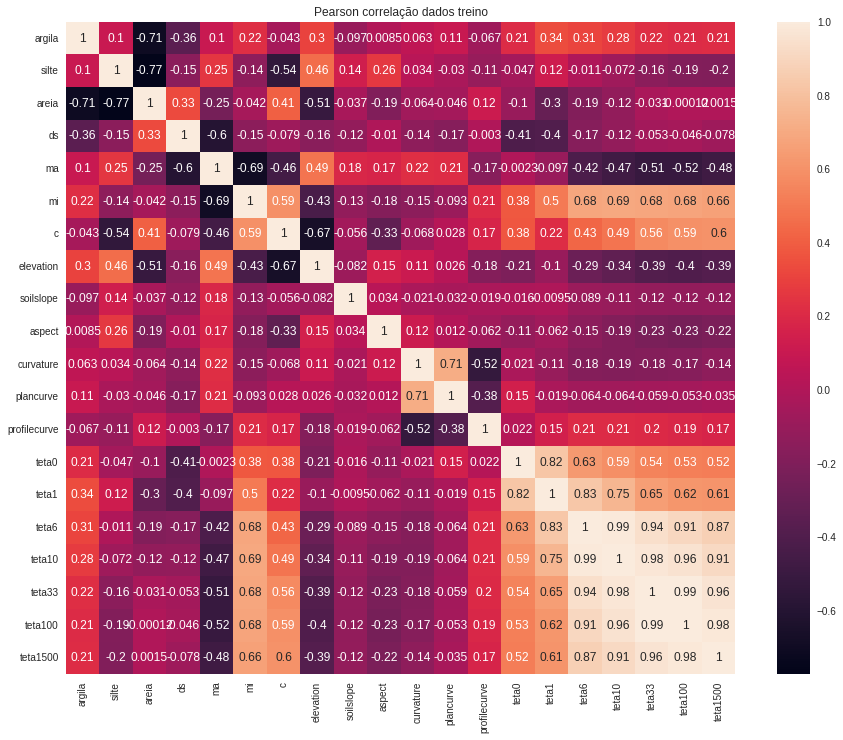

In [ ]:
sem_r = pd.read_excel('Dados de treinamento sem replicar.xlsx')
plt.figure(figsize=(15,12))
sns.heatmap(sem_r.astype(float).corr(),vmax=1.0,  annot=True)
plt.title('Pearson correlação dados treino');

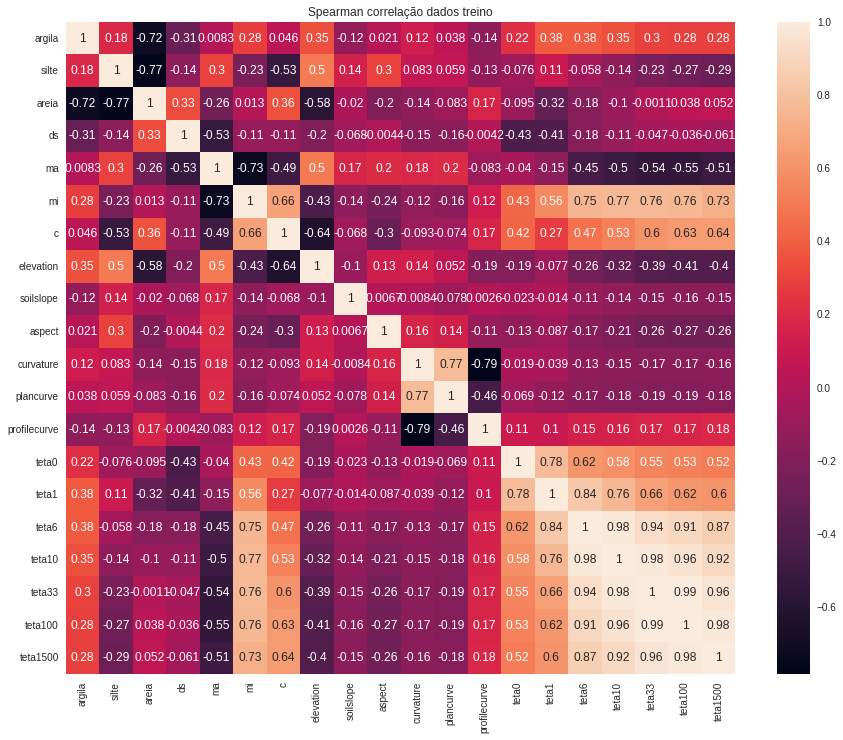

In [ ]:
sem_r = pd.read_excel('Dados de treinamento sem replicar.xlsx')
plt.figure(figsize=(15,12))
sns.heatmap(sem_r.astype(float).corr('spearman'),vmax=1.0,  annot=True)
plt.title('Spearman correlação dados treino');

###Autoviz

In [ ]:
from autoviz.AutoViz_Class import AutoViz_Class

AV = AutoViz_Class()

In [ ]:
%matplotlib inline

Shape of your Data Set loaded: (1148, 15)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
ma,162,float64,0,0.000000,14.111498,0,
argila,161,float64,0,0.000000,14.024390,0,
silte,161,float64,0,0.000000,14.024390,0,
areia,158,float64,0,0.000000,13.763066,0,
mi,157,float64,0,0.000000,13.675958,0,
elevation,148,float64,0,0.000000,12.891986,0,
aspect,142,float64,0,0.000000,12.369338,0,
soilslope,135,float64,0,0.000000,11.759582,0,
plancurve,128,float64,0,0.000000,11.149826,0,
profilecurve,124,float64,0,0.000000,10.801394,0,


    14 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Regression problem #####################


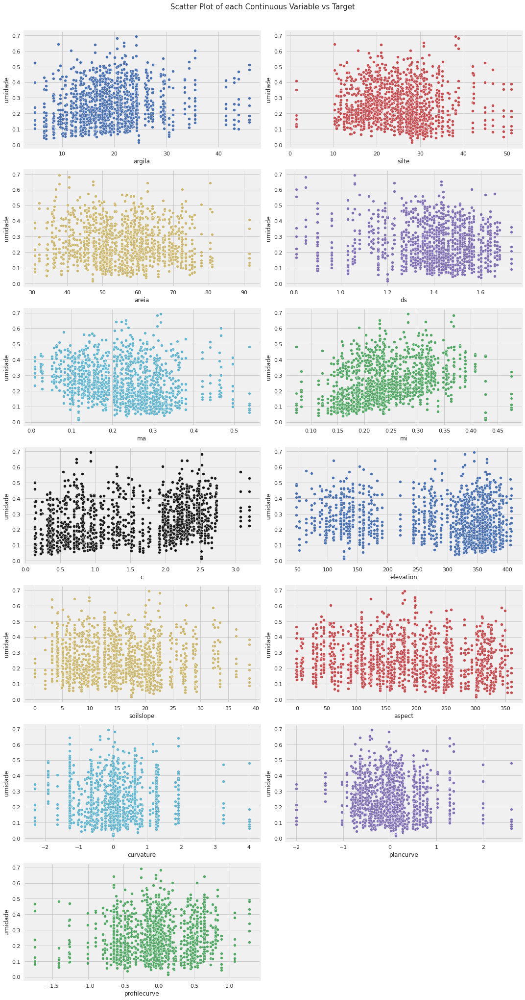

Number of All Scatter Plots = 91


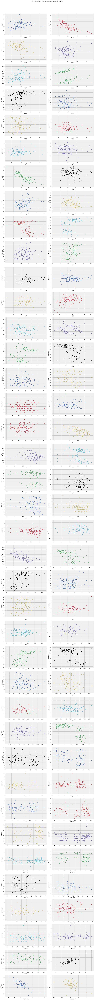

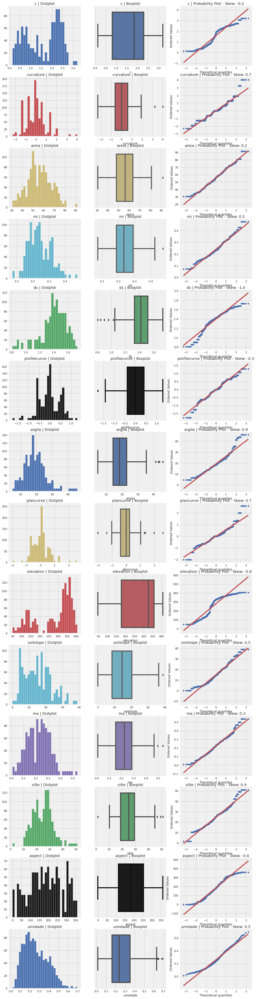

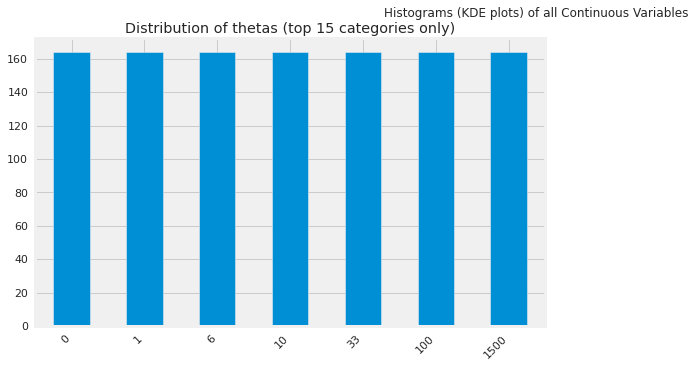

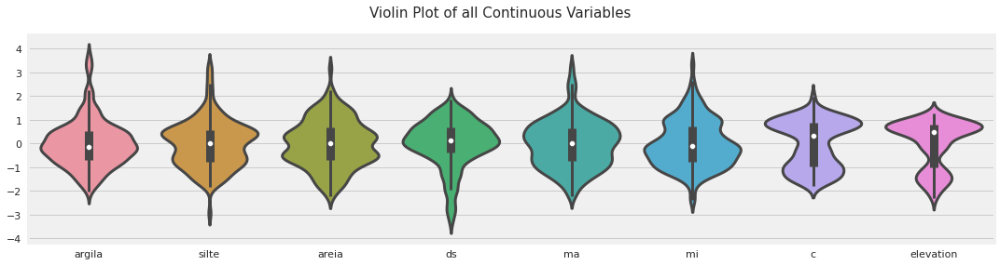

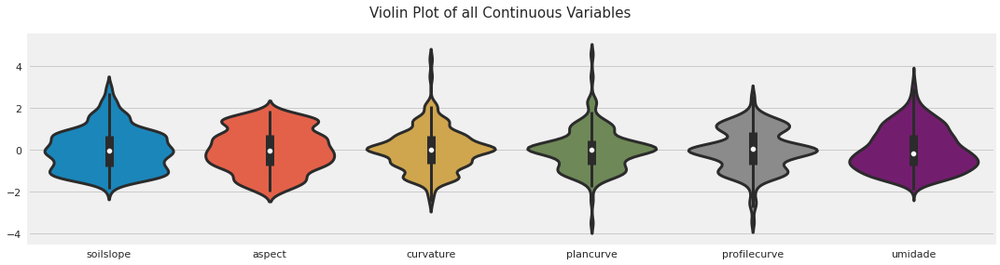

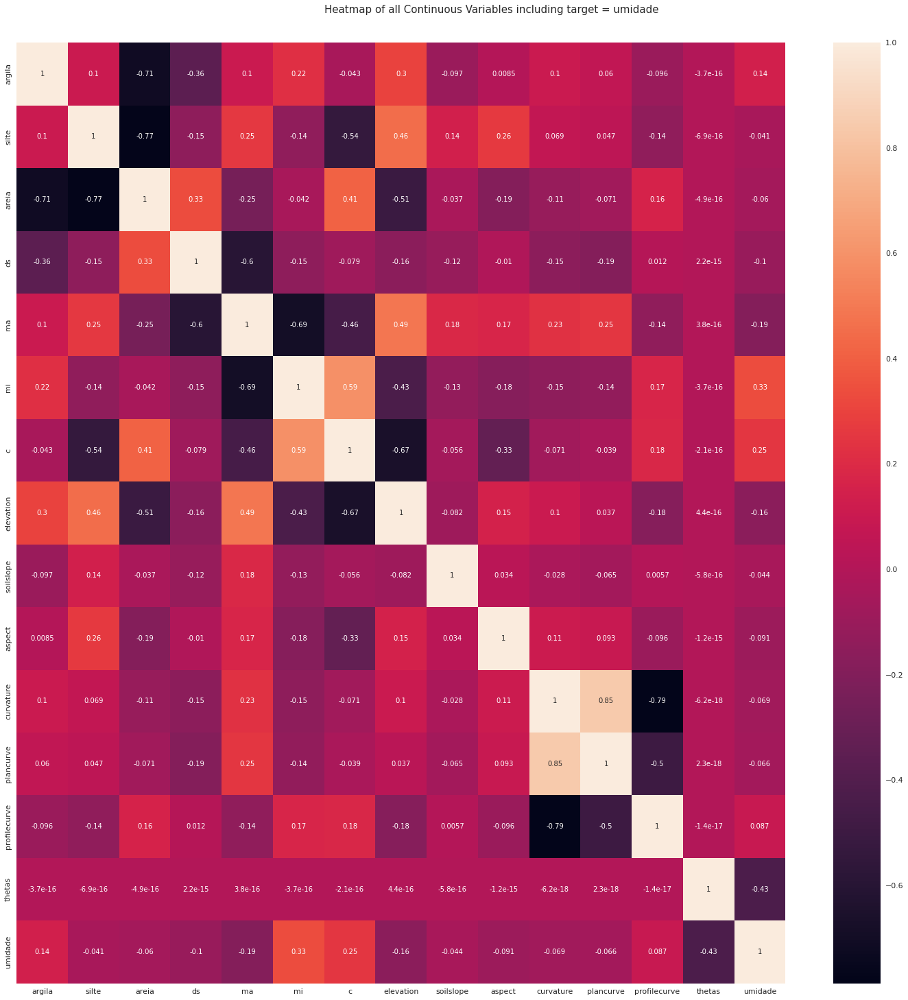

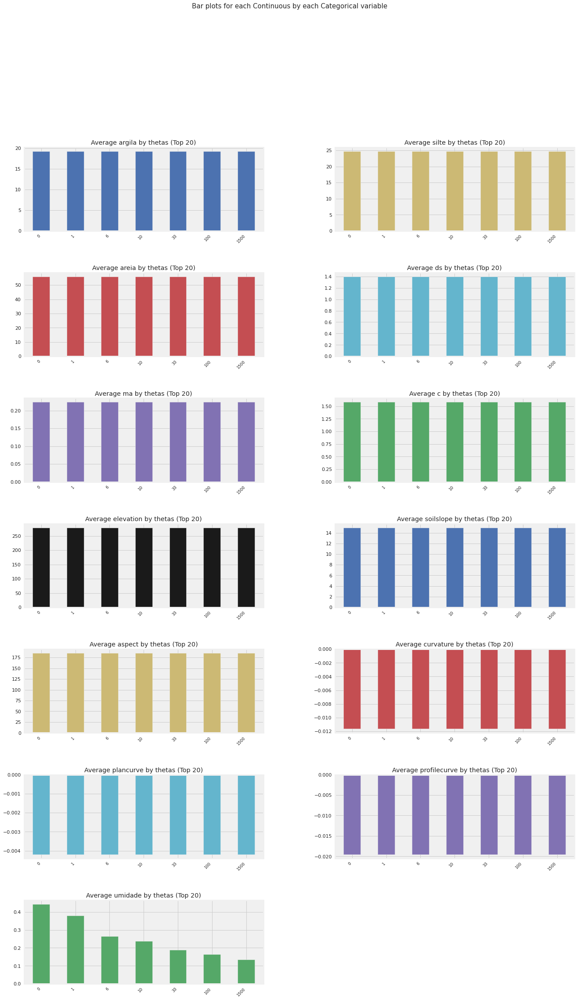

All Plots done
Time to run AutoViz = 35 seconds 

 ###################### AUTO VISUALIZATION Completed ########################


,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve,thetas,umidade
0,15.98,24.85,59.17,1.40,0.0623,0.3795,2.64,48.00,8.60,54.46,-1.9200,-0.6400,1.2800,0,0.4915
1,10.54,14.09,75.37,1.37,0.1161,0.3382,2.14,53.00,15.56,315.00,1.2800,0.8000,-0.4800,0,0.4105
2,21.99,32.06,45.95,1.66,0.0800,0.2742,2.38,64.00,5.10,258.69,0.6400,0.0000,-0.6400,0,0.5750
3,20.52,22.38,57.10,1.61,0.0515,0.3186,2.41,114.00,22.36,26.57,-1.2800,-0.9224,0.3576,0,0.4187
4,18.99,27.54,53.47,1.51,0.0693,0.3211,2.48,127.00,32.53,45.00,0.0000,-0.1600,-0.1600,0,0.5100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1143,34.33,29.36,36.31,1.36,0.2501,0.2381,1.47,388.57,6.08,311.06,0.6775,0.5054,-0.1721,1500,0.1099
1144,22.99,27.50,49.51,1.37,0.2749,0.2088,0.94,391.23,9.59,171.32,0.1862,-0.4123,-0.5985,1500,0.0889
1145,25.87,22.98,51.15,1.33,0.3084,0.1889,0.82,392.20,9.26,124.00,0.5890,0.1598,-0.4292,1500,0.1259
1146,17.37,30.60,52.03,1.64,0.1762,0.2032,0.76,387.55,8.10,237.91,-0.0763,-0.0686,0.0077,1500,0.0776


In [ ]:
AV.AutoViz(filename='', dfte=data, depVar='umidade')

##Modelos treinados para $\theta$s individuais

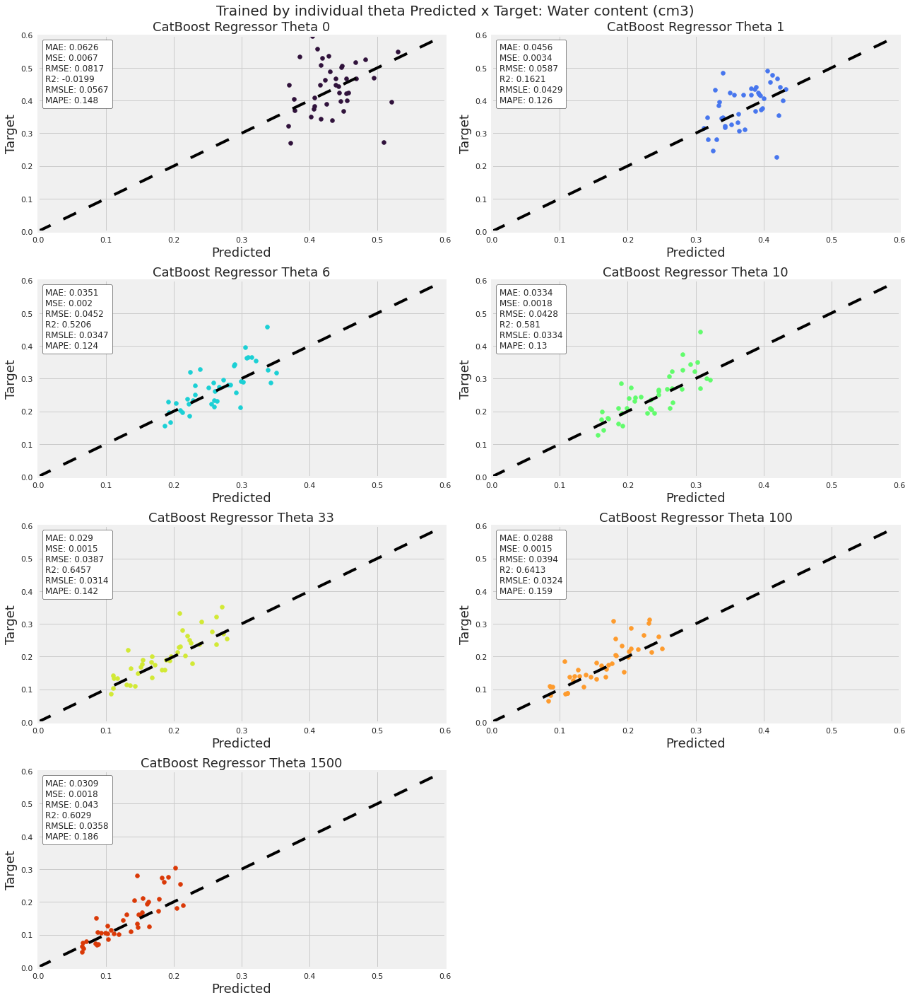

In [ ]:
model_testing_by_H(THETAS, 'catboost', data, validation);

**THETAS: 0, 1**

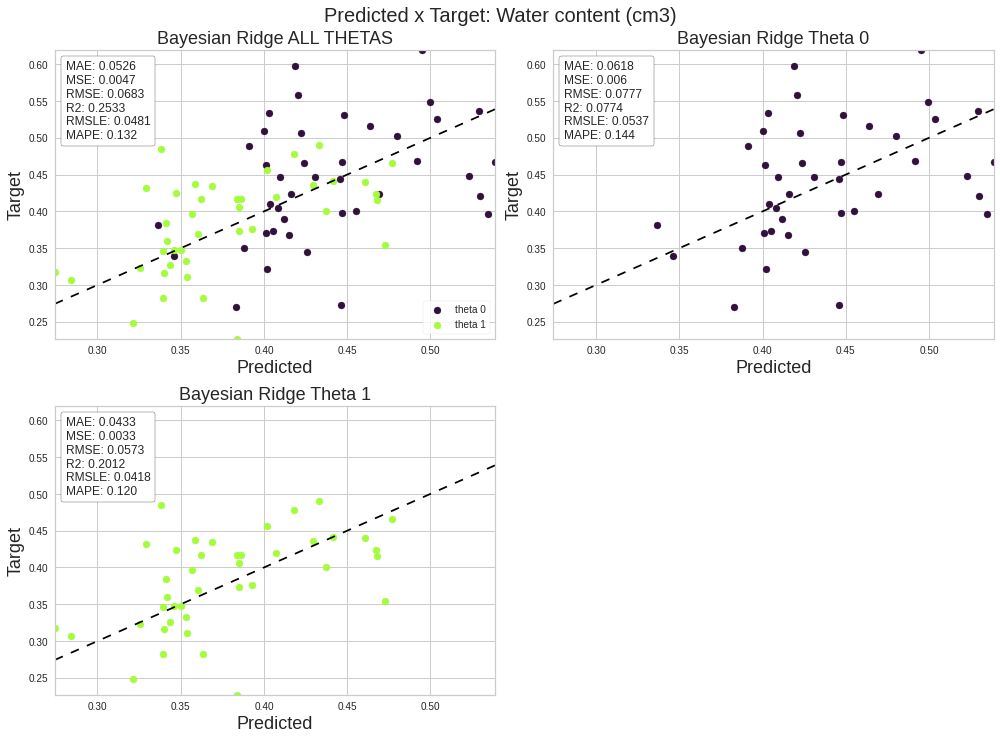

In [ ]:
query = 'thetas == 0 or thetas == 1'
data_tuple = (trn.query(query), tst.query(query), validation.query(query))
all = test_model(data_tuple, fold_gen);

**THETAS:  6,   10,   33**

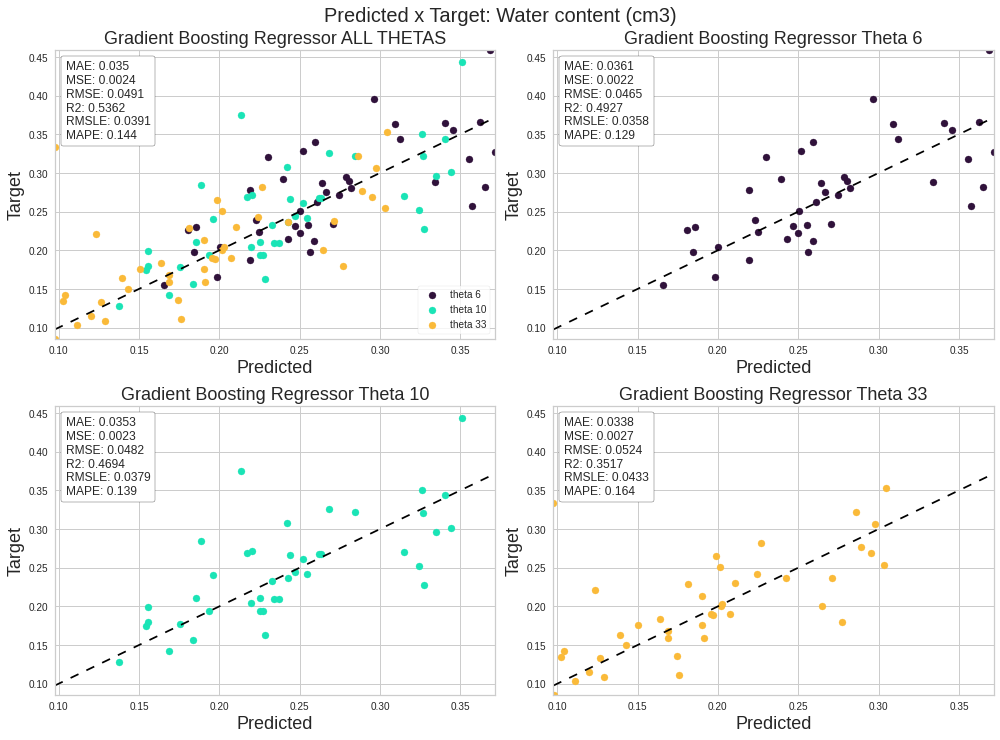

In [ ]:
query = 'thetas == 6 or thetas == 10 or thetas == 33'
data_tuple = (trn.query(query), tst.query(query), validation.query(query))
all = test_model(data_tuple, fold_gen);

THETAS: 100, 1500

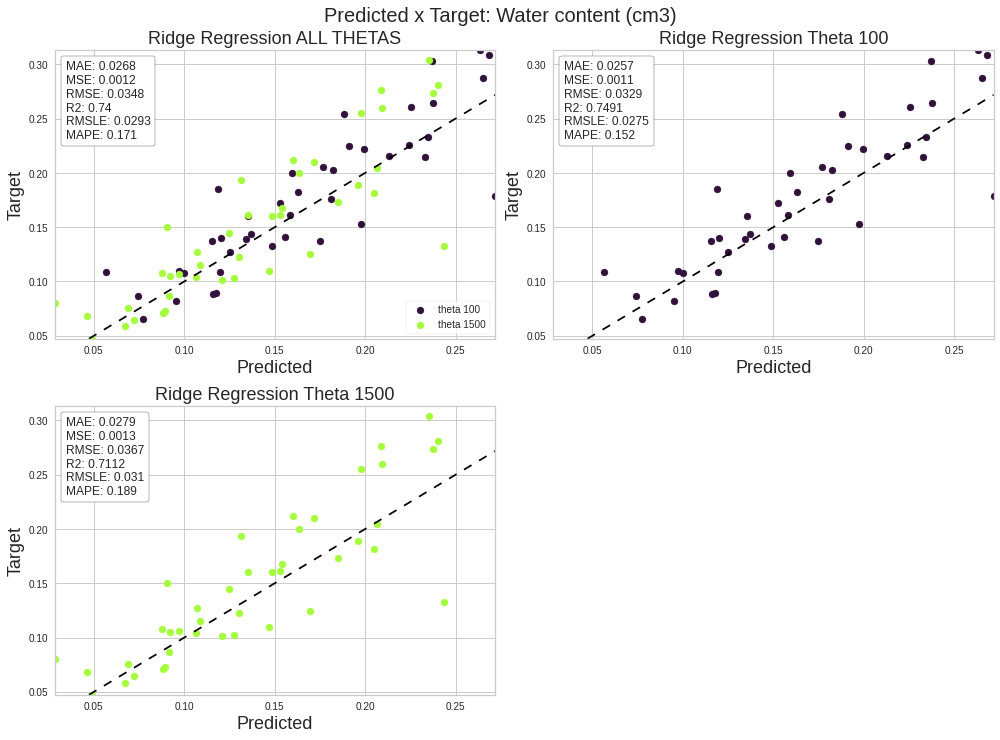

In [ ]:
query = 'thetas == 100 or thetas == 1500'
data_tuple = (trn.query(query), tst.query(query), validation.query(query))
all = test_model(data_tuple, fold_gen);

THETAS: 0, 1500

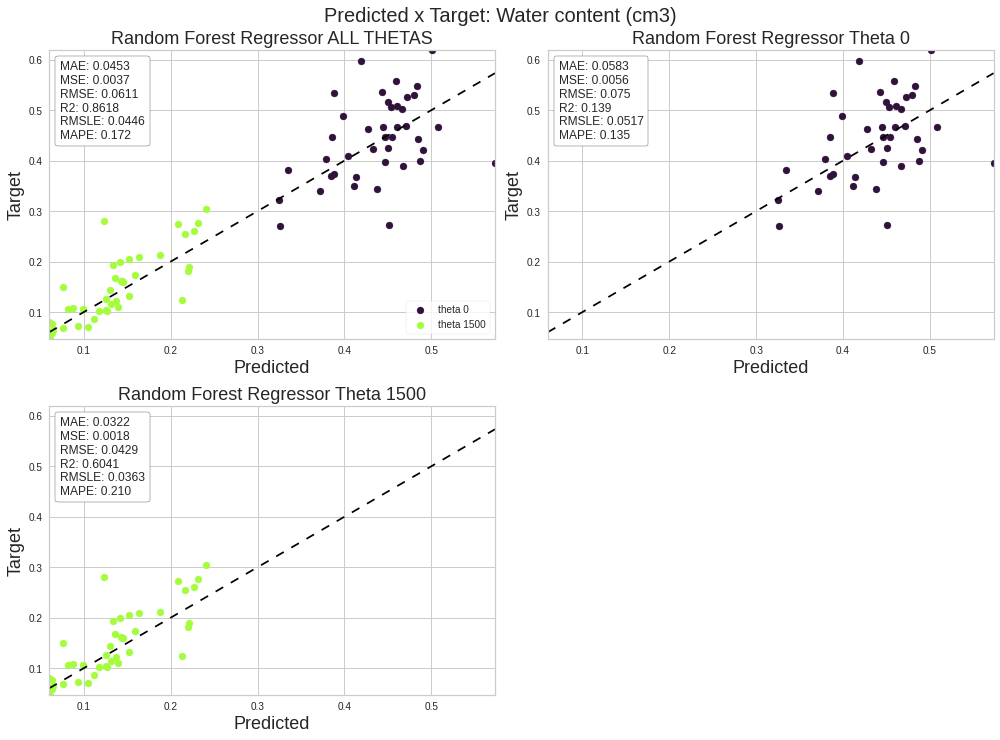

In [ ]:
query = 'thetas == 0 or thetas == 1500'
data_tuple = (trn.query(query), tst.query(query), validation.query(query))
all = test_model(data_tuple, fold_gen);

##Experiemento normalização

In [ ]:
from sklearn.preprocessing import StandardScaler

###Standard Scaler

In [ ]:
std = StandardScaler()
t1 = trn.query('thetas == 0').drop(columns=['thetas', 'umidade'])
t2 = trn.drop(columns=['thetas', 'umidade'])

In [ ]:
t1.head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,26.31,24.66,49.03,1.14,0.1842,0.3482,3.20,350.00,22.63,135.00,0.0000,0.0000,0.0000
40,12.66,19.80,67.53,1.57,0.0897,0.3066,2.33,127.00,17.49,59.04,0.0000,-0.1280,-0.1280
41,17.74,23.49,58.77,1.51,0.1080,0.3196,2.33,143.00,28.64,102.09,-0.6400,-0.0483,0.5917
147,15.07,29.33,55.60,1.38,0.3311,0.1499,0.49,373.99,11.44,249.57,-0.0458,0.4969,0.5427
45,9.65,17.99,72.37,1.35,0.2047,0.2790,1.97,221.00,27.17,173.66,-1.2800,-0.5952,0.6848


In [ ]:
t2.head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
241,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
405,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
569,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
733,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0


In [ ]:
std.fit(t1)
t1[:] = std.transform(t1)
t1.head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,0.889404,-0.109562,-0.527654,-1.397570,-0.411452,1.435153,1.956248,0.653337,0.881939,-0.548896,-0.045269,-0.018035,0.060856
40,-0.975541,-0.732583,1.198383,1.033718,-1.411389,0.854555,0.901894,-1.505941,0.240742,-1.379004,-0.045269,-0.246947,-0.198768
41,-0.281481,-0.259548,0.381081,0.694469,-1.217750,1.035992,0.901894,-1.351015,1.631665,-0.908544,-0.747589,-0.104414,1.261008
147,-0.646272,0.489103,0.085323,-0.040572,1.142946,-1.332459,-1.328002,0.885628,-0.513975,0.703152,-0.095529,0.870606,1.161621
45,-1.386785,-0.964613,1.649951,-0.210197,-0.194535,0.469350,0.465610,-0.595752,1.448288,-0.126410,-1.449910,-1.082473,1.449844


In [ ]:
std.fit(t2)
t2[:] = std.transform(t2)
t2.drop_duplicates().head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,0.889404,-0.109562,-0.527654,-1.397570,-0.411452,1.435153,1.956248,0.653337,0.881939,-0.548896,-0.045269,-0.018035,0.060856
40,-0.975541,-0.732583,1.198383,1.033718,-1.411389,0.854555,0.901894,-1.505941,0.240742,-1.379004,-0.045269,-0.246947,-0.198768
41,-0.281481,-0.259548,0.381081,0.694469,-1.217750,1.035992,0.901894,-1.351015,1.631665,-0.908544,-0.747589,-0.104414,1.261008
147,-0.646272,0.489103,0.085323,-0.040572,1.142946,-1.332459,-1.328002,0.885628,-0.513975,0.703152,-0.095529,0.870606,1.161621
45,-1.386785,-0.964613,1.649951,-0.210197,-0.194535,0.469350,0.465610,-0.595752,1.448288,-0.126410,-1.449910,-1.082473,1.449844


In [ ]:
std = StandardScaler()
t1 = trn.query('thetas == 0').drop(columns=['thetas', 'umidade'])
t2 = trn.drop(columns=['thetas', 'umidade'])

In [ ]:
t1.head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,26.31,24.66,49.03,1.14,0.1842,0.3482,3.20,350.00,22.63,135.00,0.0000,0.0000,0.0000
40,12.66,19.80,67.53,1.57,0.0897,0.3066,2.33,127.00,17.49,59.04,0.0000,-0.1280,-0.1280
41,17.74,23.49,58.77,1.51,0.1080,0.3196,2.33,143.00,28.64,102.09,-0.6400,-0.0483,0.5917
147,15.07,29.33,55.60,1.38,0.3311,0.1499,0.49,373.99,11.44,249.57,-0.0458,0.4969,0.5427
45,9.65,17.99,72.37,1.35,0.2047,0.2790,1.97,221.00,27.17,173.66,-1.2800,-0.5952,0.6848


In [ ]:
t2.head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
241,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
405,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
569,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0
733,26.31,24.66,49.03,1.14,0.1842,0.3482,3.2,350.0,22.63,135.0,0.0,0.0,0.0


In [ ]:
std.fit(t1)
t1[:] = std.transform(t1)
t1.head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,0.889404,-0.109562,-0.527654,-1.397570,-0.411452,1.435153,1.956248,0.653337,0.881939,-0.548896,-0.045269,-0.018035,0.060856
40,-0.975541,-0.732583,1.198383,1.033718,-1.411389,0.854555,0.901894,-1.505941,0.240742,-1.379004,-0.045269,-0.246947,-0.198768
41,-0.281481,-0.259548,0.381081,0.694469,-1.217750,1.035992,0.901894,-1.351015,1.631665,-0.908544,-0.747589,-0.104414,1.261008
147,-0.646272,0.489103,0.085323,-0.040572,1.142946,-1.332459,-1.328002,0.885628,-0.513975,0.703152,-0.095529,0.870606,1.161621
45,-1.386785,-0.964613,1.649951,-0.210197,-0.194535,0.469350,0.465610,-0.595752,1.448288,-0.126410,-1.449910,-1.082473,1.449844


In [ ]:
std.fit(t2)
t2[:] = std.transform(t2)
t2.drop_duplicates().head()

,argila,silte,areia,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve
77,0.889404,-0.109562,-0.527654,-1.397570,-0.411452,1.435153,1.956248,0.653337,0.881939,-0.548896,-0.045269,-0.018035,0.060856
40,-0.975541,-0.732583,1.198383,1.033718,-1.411389,0.854555,0.901894,-1.505941,0.240742,-1.379004,-0.045269,-0.246947,-0.198768
41,-0.281481,-0.259548,0.381081,0.694469,-1.217750,1.035992,0.901894,-1.351015,1.631665,-0.908544,-0.747589,-0.104414,1.261008
147,-0.646272,0.489103,0.085323,-0.040572,1.142946,-1.332459,-1.328002,0.885628,-0.513975,0.703152,-0.095529,0.870606,1.161621
45,-1.386785,-0.964613,1.649951,-0.210197,-0.194535,0.469350,0.465610,-0.595752,1.448288,-0.126410,-1.449910,-1.082473,1.449844


##Feature Enginering


###Feature importance

In [ ]:
def get_feature_importance(data_tuple, fold, n_sel=5):
  trn, tst = data_tuple
  exp_reg = setup(data = trn,
                test_data=tst, 
                target = 'umidade',
                normalize=True, 
                session_id=123, 
                silent=True,
                numeric_features=['thetas'],
                fold_strategy=fold,
                use_gpu=True,
                verbose=False);

  best_models = compare_models(n_select=n_sel, verbose=False)
  names = pull().Model[:n_sel]
  df = pd.DataFrame(index=trn.columns[:-1])
  for i, model in enumerate(best_models):
    df[names[i]] = model.feature_importances_
  return df, best_models

In [ ]:
df_fi, fi_m = get_feature_importance((trn, tst), fold_gen)

In [ ]:
fi_c = df_fi.columns.to_list()

In [ ]:
df_fi.sort_values(fi_c, ascending=False)

,Gradient Boosting Regressor,Random Forest Regressor,Extra Trees Regressor,CatBoost Regressor,Light Gradient Boosting Machine
thetas,0.722874,0.696753,0.696169,57.089293,503
mi,0.157119,0.159962,0.101558,12.022951,326
c,0.021283,0.016454,0.034681,3.406003,178
argila,0.017610,0.013951,0.020623,3.614263,187
ds,0.017092,0.021690,0.023888,2.920132,254
areia,0.014333,0.015335,0.019827,2.851883,190
ma,0.012425,0.013266,0.023051,3.099701,204
elevation,0.010949,0.009185,0.011455,2.972866,162
plancurve,0.006888,0.010226,0.012254,2.639453,140
profilecurve,0.005675,0.010379,0.011260,1.943463,143


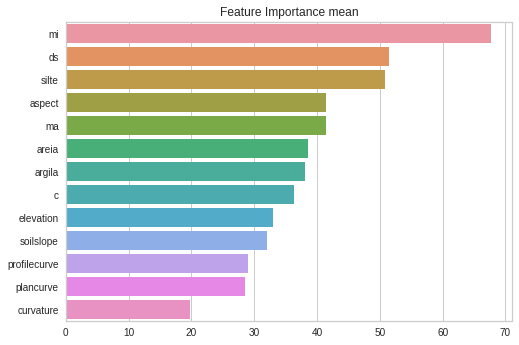

In [ ]:
feature_mean = data=df_fi.mean(axis=1).drop('thetas').sort_values(ascending=False)
sns.barplot(y=feature_mean.index, x=feature_mean);
plt.title('Feature Importance mean');

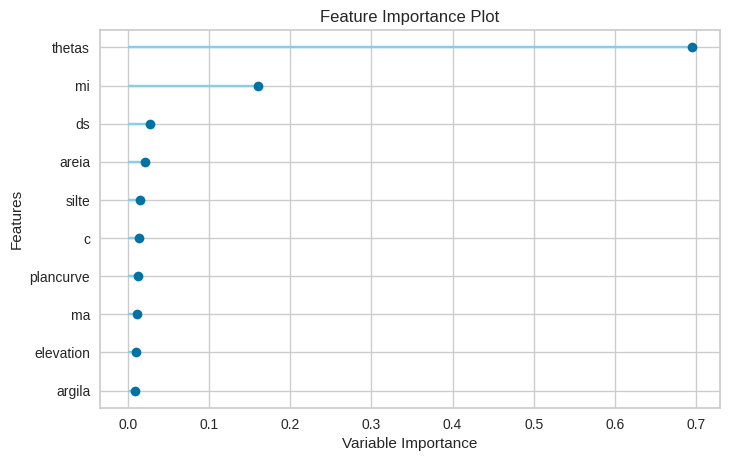

In [ ]:
plot_model(fi_m[0], plot = 'feature')

In [ ]:
# et = create_model('Extra Trees Regressor')

In [ ]:
fi_m[2]

ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)

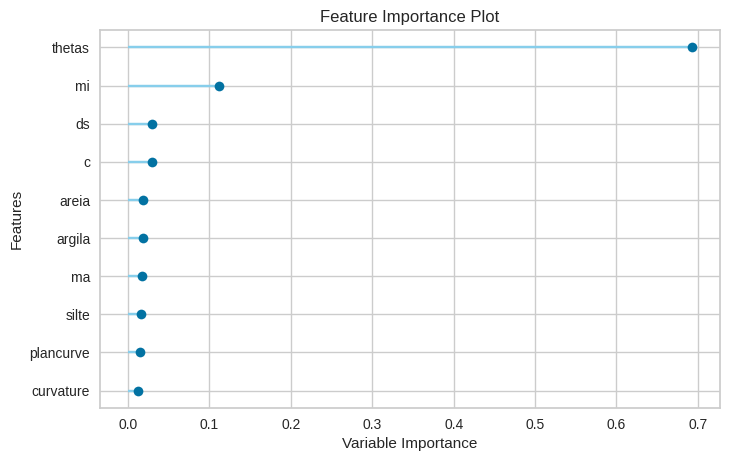

In [ ]:
plot_model(fi_m[2], plot = 'feature')

###Criação de atributos com pycaret

In [ ]:
exp_reg = setup(data = trn,
                test_data=tst, 
                target = 'umidade',
                normalize=True, 
                session_id=123, 
                silent=True,
                numeric_features=['thetas'],
                #data_split_shuffle=False,
                #data_split_stratify=['tetas'],
                fold_strategy=fold_gen,
                use_gpu=True,
                #normalize_method='robust',
                #fold_strategy='ff'
                feature_interaction=True,
                feature_ratio=True,
                polynomial_features=True,
                trigonometry_features = True,
                create_clusters=True
                )

,Description,Value
0,session_id,123
1,Target,umidade
2,Original Data,"(917, 15)"
3,Missing Values,False
4,Numeric Features,14
5,Categorical Features,0
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(917, 42)"


In [ ]:
get_config('X').columns

Index(['argila', 'silte', 'areia', 'ma', 'mi', 'elevation', 'soilslope',
       'aspect', 'curvature', 'plancurve', 'profilecurve', 'thetas',
       'areia_Power2', 'mi_Power2', 'sin(thetas)', 'tan(thetas)', 'cos(c)',
       'cos(thetas)', 'cos(argila)', 'cos(aspect)', 'ds_Power2',
       'data_cluster_1', 'sin(thetas)_divide_tan(thetas)',
       'sin(thetas)_multiply_mi', 'tan(thetas)_multiply_sin(thetas)',
       'cos(argila)_multiply_soilslope', 'ds_Power2_divide_sin(thetas)',
       'areia_Power2_divide_ma', 'soilslope_divide_ma',
       'cos(argila)_divide_sin(thetas)', 'tan(thetas)_divide_sin(thetas)',
       'cos(thetas)_divide_tan(thetas)', 'silte_divide_sin(thetas)',
       'cos(c)_divide_sin(thetas)', 'tan(thetas)_multiply_thetas',
       'sin(thetas)_multiply_tan(thetas)', 'cos(thetas)_divide_sin(thetas)',
       'thetas_divide_sin(thetas)', 'thetas_multiply_tan(thetas)',
       'thetas_divide_tan(thetas)', 'data_cluster_1_multiply_cos(c)',
       'mi_Power2_divide_thetas'],

In [ ]:
best = compare_models(n_select=5)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,1.690000e-02,7.000000e-04,2.550000e-02,9.589000e-01,0.0185,6.730000e-02,5.844
lightgbm,Light Gradient Boosting Machine,1.990000e-02,9.000000e-04,2.950000e-02,9.450000e-01,0.0217,8.220000e-02,1.157
gbr,Gradient Boosting Regressor,2.270000e-02,1.000000e-03,3.170000e-02,9.363000e-01,0.0236,9.760000e-02,0.545
rf,Random Forest Regressor,2.800000e-02,1.600000e-03,4.010000e-02,8.981000e-01,0.0301,1.244000e-01,3.371
et,Extra Trees Regressor,2.820000e-02,1.700000e-03,4.040000e-02,8.965000e-01,0.0301,1.214000e-01,1.393
lr,Linear Regression,3.450000e-02,2.200000e-03,4.630000e-02,8.643000e-01,0.0355,1.611000e-01,0.025
ridge,Ridge Regression,3.450000e-02,2.200000e-03,4.640000e-02,8.637000e-01,0.0355,1.619000e-01,0.031
br,Bayesian Ridge,3.450000e-02,2.200000e-03,4.640000e-02,8.637000e-01,0.0355,1.619000e-01,0.061
huber,Huber Regressor,3.470000e-02,2.500000e-03,4.990000e-02,8.422000e-01,0.0383,1.650000e-01,0.305
ada,AdaBoost Regressor,4.070000e-02,2.600000e-03,5.050000e-02,8.389000e-01,0.0393,2.123000e-01,0.281


In [ ]:
evaluate_model(best[0])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

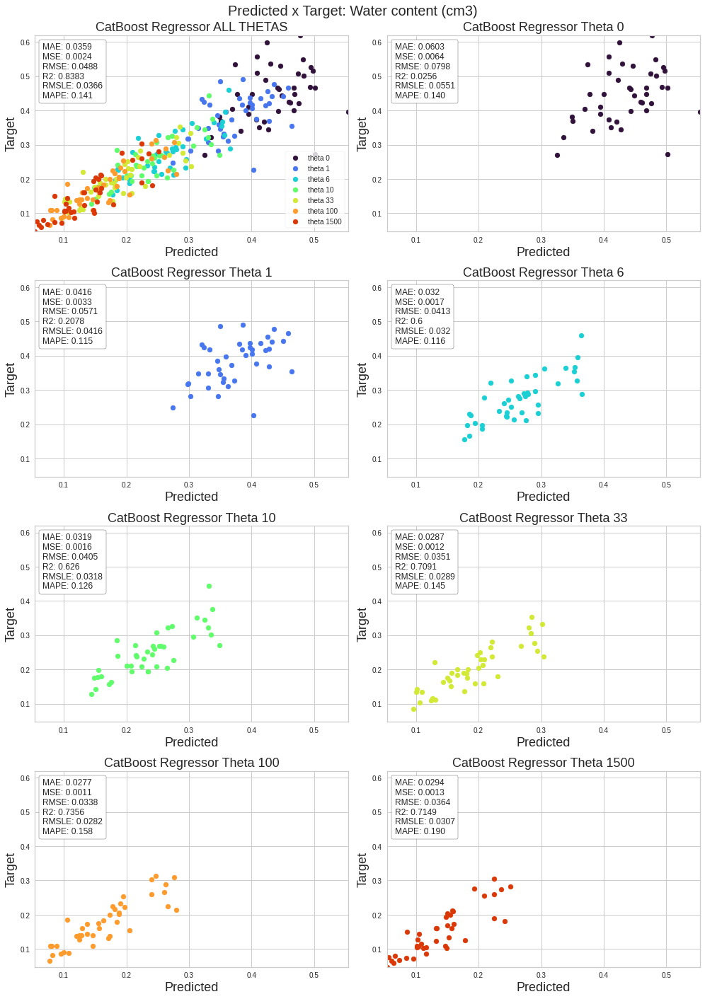

In [ ]:
all = plot_results_pyc('umidade', best[0], validation)

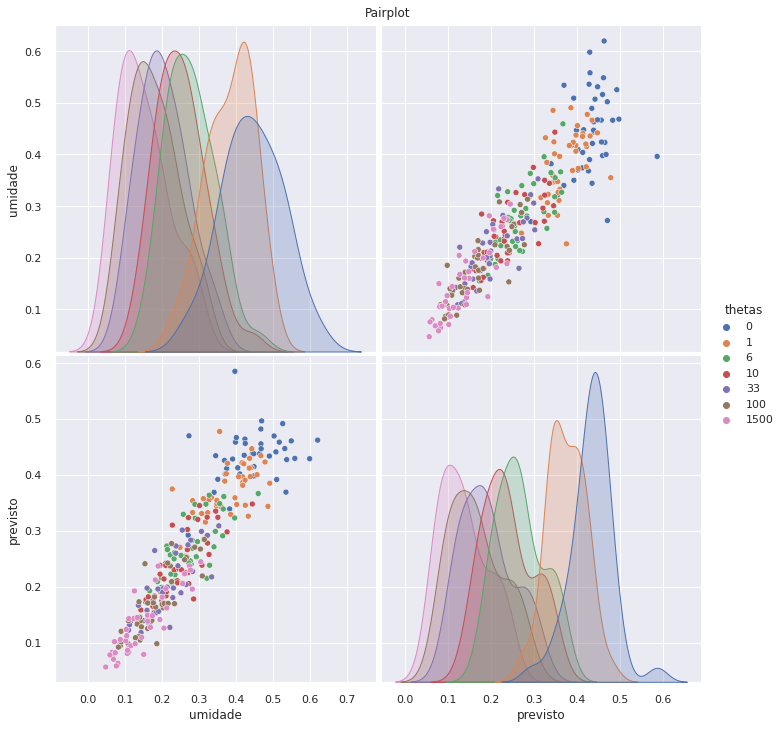

In [ ]:
sel = all[all.columns[-3:]]
sel['thetas'] = sel.thetas.apply(lambda x: str(x))
sel = sel.rename({'Label':'previsto'}, axis=1)
plot = sns.pairplot(sel, hue='thetas', height=5,);
plot.fig.suptitle("Pairplot", y=1.01);

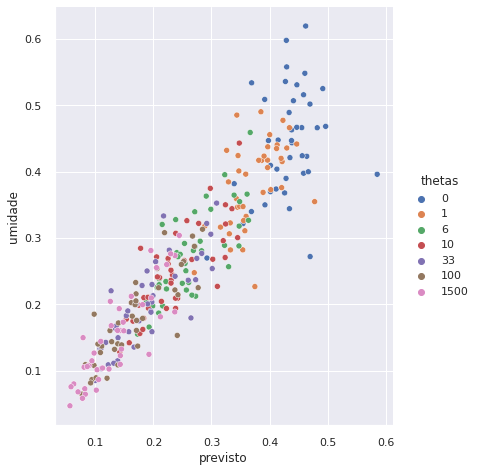

In [ ]:
plot = sns.relplot(data=sel, 
            x='previsto',
            y='umidade',
            hue='thetas');
plot.fig.set_size_inches(7, 7)

###Classe textural

In [ ]:
ct_trn = textural_class_column(trn)
ct_tst = textural_class_column(tst)

In [ ]:
dados_trn = textural_class_column(trn)

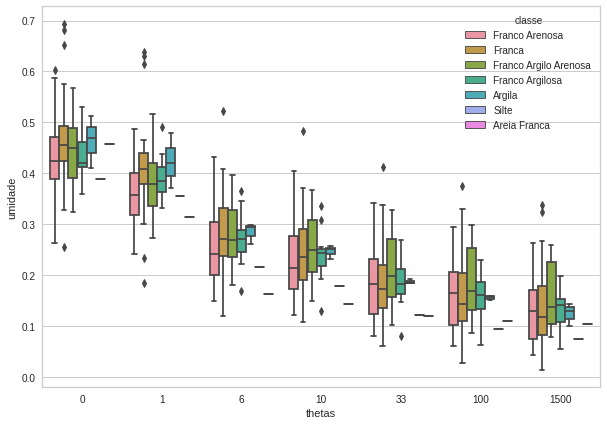

In [ ]:
thetas_cat = dados_trn.thetas.apply(lambda x: str(x))
plt.figure(figsize=(10,7))
sns.boxplot(data=dados_trn, x=thetas_cat, y='umidade', hue='classe');

In [ ]:
ct_trn.head()

,classe,ds,ma,mi,c,elevation,soilslope,aspect,curvature,plancurve,profilecurve,thetas,umidade
154,Franco Arenosa,1.34,0.3128,0.1804,1.52,404.56,10.8,311.46,0.0153,-0.1975,-0.2128,0,0.5230
318,Franco Arenosa,1.34,0.3128,0.1804,1.52,404.56,10.8,311.46,0.0153,-0.1975,-0.2128,1,0.3977
482,Franco Arenosa,1.34,0.3128,0.1804,1.52,404.56,10.8,311.46,0.0153,-0.1975,-0.2128,6,0.2376
646,Franco Arenosa,1.34,0.3128,0.1804,1.52,404.56,10.8,311.46,0.0153,-0.1975,-0.2128,10,0.2064
810,Franco Arenosa,1.34,0.3128,0.1804,1.52,404.56,10.8,311.46,0.0153,-0.1975,-0.2128,33,0.1566


In [ ]:
df_ct = pd.concat([ct_trn, ct_tst])

In [ ]:
df_ct.classe.mode()

0    Franco Arenosa
dtype: object

In [ ]:
df_ct.classe.value_counts()/7

Franco Arenosa           77.0
Franca                   33.0
Franco Argilo Arenosa    32.0
Franco Argilosa          14.0
Argila                    4.0
Areia Franca              2.0
Areia                     1.0
Silte                     1.0
Name: classe, dtype: float64

In [ ]:
textural_class_column(validation).classe.value_counts()/7

Franco Arenosa           18.0
Franca                   10.0
Franco Argilo Arenosa     6.0
Franco Argilosa           5.0
Areia Franca              1.0
Argila                    1.0
Name: classe, dtype: float64

In [ ]:
exp_reg = setup(data = trn,
                test_data=tst, 
                target = 'umidade',
                normalize=True, 
                session_id=123, 
                silent=True,
                numeric_features=['thetas'],
                #data_split_shuffle=False,
                #data_split_stratify=['tetas'],
                fold_strategy=fold_gen,
                use_gpu=True,
                #normalize_method='robust',
                #fold_strategy='ff'
                )

,Description,Value
0,session_id,123
1,Target,umidade
2,Original Data,"(917, 13)"
3,Missing Values,False
4,Numeric Features,11
5,Categorical Features,1
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(917, 19)"


In [ ]:
best = compare_models(n_select=5)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,0.0362,0.0025,0.0499,0.8334,0.0377,0.1545,0.846
catboost,CatBoost Regressor,0.0382,0.0027,0.0520,0.8195,0.0394,0.1616,1.450
gbr,Gradient Boosting Regressor,0.0389,0.0029,0.0532,0.8106,0.0405,0.1674,0.276
et,Extra Trees Regressor,0.0383,0.0029,0.0529,0.8085,0.0402,0.1623,0.967
ada,AdaBoost Regressor,0.0443,0.0033,0.0568,0.7857,0.0438,0.2137,0.343
lightgbm,Light Gradient Boosting Machine,0.0409,0.0033,0.0566,0.7821,0.0431,0.1771,0.576
dt,Decision Tree Regressor,0.0487,0.0044,0.0654,0.7137,0.0498,0.2085,0.011
br,Bayesian Ridge,0.0831,0.0109,0.1042,0.2767,0.0801,0.3834,0.010
ridge,Ridge Regression,0.0837,0.0110,0.1047,0.2688,0.0805,0.3849,0.015
lr,Linear Regression,0.0837,0.0110,0.1048,0.2675,0.0805,0.3848,0.008


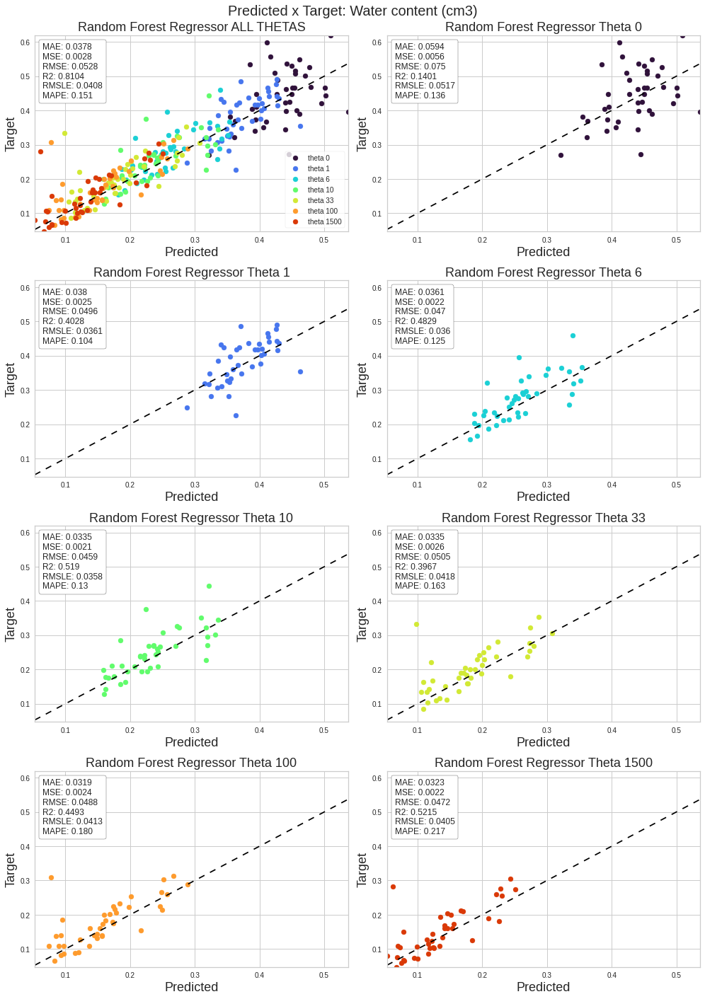

In [ ]:
all = plot_results_pyc('umidade', best[0], textural_class_column(validation))

### Classe textural e sem atributos topograficos

In [ ]:
c = ['classe',	'ds',	'ma',	'mi',	'c',	'thetas',	'umidade']

In [ ]:
exp_reg = setup(data = trn[c],
                test_data=tst[c], 
                target = 'umidade',
                normalize=True, 
                session_id=123, 
                silent=True,
                numeric_features=['thetas'],
                #data_split_shuffle=False,
                #data_split_stratify=['tetas'],
                fold_strategy=fold_gen,
                use_gpu=True,
                #normalize_method='robust',
                #fold_strategy='ff'
                )

,Description,Value
0,session_id,123
1,Target,umidade
2,Original Data,"(917, 7)"
3,Missing Values,False
4,Numeric Features,5
5,Categorical Features,1
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(917, 13)"


In [ ]:
best = compare_models(n_select=5)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,0.0340,0.0027,0.0508,0.8269,0.0378,0.1393,1.066
gbr,Gradient Boosting Regressor,0.0352,0.0027,0.0506,0.8265,0.0379,0.1491,0.106
catboost,CatBoost Regressor,0.0366,0.0029,0.0529,0.8121,0.0396,0.1517,0.802
lightgbm,Light Gradient Boosting Machine,0.0379,0.0029,0.0532,0.8121,0.0400,0.1608,0.065
et,Extra Trees Regressor,0.0372,0.0031,0.0549,0.8005,0.0410,0.1526,1.525
ada,AdaBoost Regressor,0.0469,0.0036,0.0597,0.7667,0.0463,0.2439,0.120
dt,Decision Tree Regressor,0.0459,0.0048,0.0680,0.6942,0.0510,0.1932,0.013
knn,K Neighbors Regressor,0.0828,0.0115,0.1068,0.2571,0.0815,0.3701,0.019
br,Bayesian Ridge,0.0849,0.0118,0.1081,0.2410,0.0825,0.3892,0.013
ridge,Ridge Regression,0.0851,0.0119,0.1084,0.2350,0.0828,0.3901,0.012


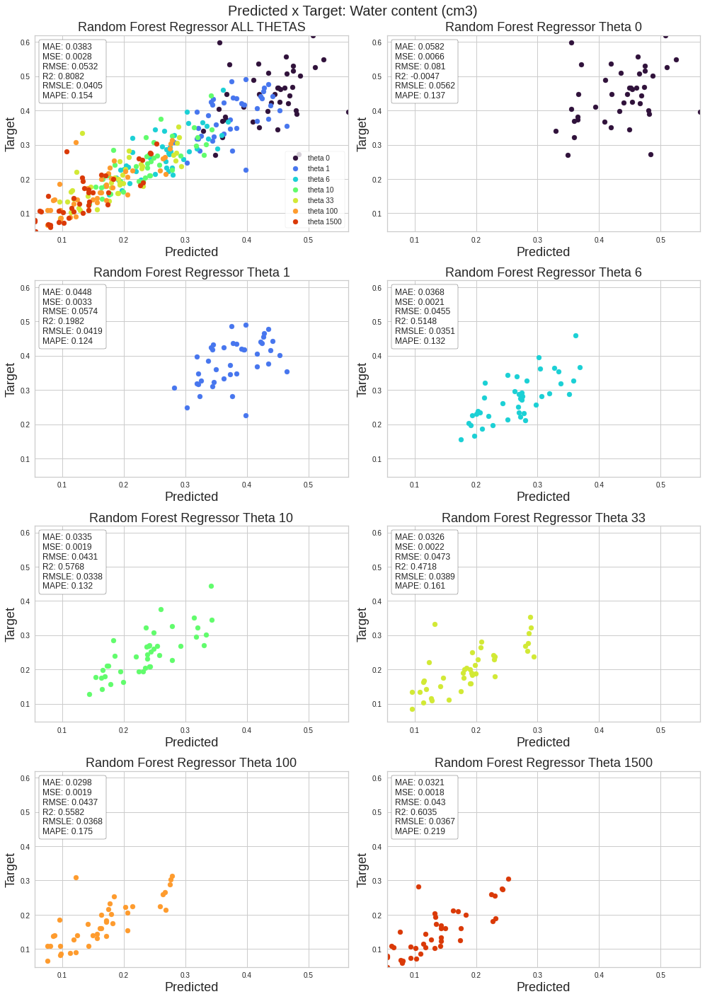

In [ ]:
all = plot_results_pyc('umidade', best[0], textural_class_column(validation)[c])

##Porosidade total

In [ ]:
pt = data.ma + data.mi

In [ ]:
data_pt = data.assign(p_total = data.ma + data.mi).drop(['ma', 'mi'], axis=1)
val_pt = validation.assign(p_total = data.ma + data.mi).drop(['ma', 'mi'], axis=1)

In [ ]:
trn_pt, tst_pt = get_trn_tst(data_pt)

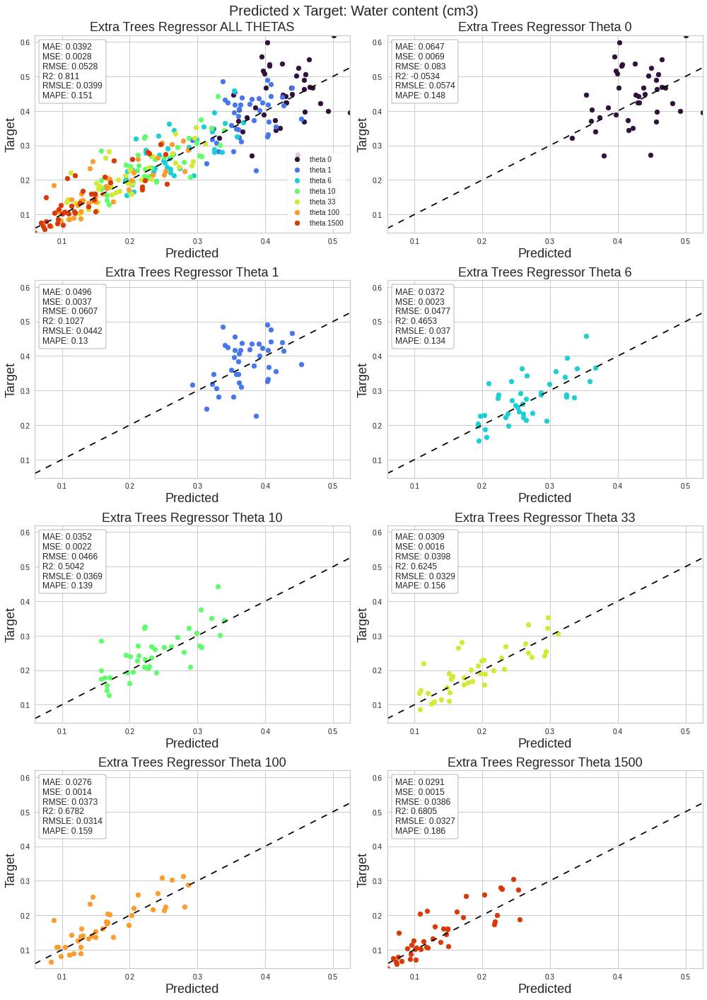

In [ ]:
all = test_model((trn_pt, tst_pt, val_pt), fold_gen)

##Raw Teste

In [ ]:
c = ['areia', 'silte', 'ds', 'mi','ma',	'thetas',	'umidade']

In [ ]:
exp_reg = setup(data = trn[c],
                test_data=tst[c], 
                target = 'umidade',
                normalize=True, 
                session_id=123, 
                silent=True,
                numeric_features=['thetas'],
                #data_split_shuffle=False,
                #data_split_stratify=['tetas'],
                fold_strategy=fold_gen,
                use_gpu=True,
                #normalize_method='robust',
                #fold_strategy='ff'
                # feature_interaction=True,
                # feature_ratio=True,
                # polynomial_features=True
               # remove_outliers=True,
                )

,Description,Value
0,session_id,123
1,Target,umidade
2,Original Data,"(917, 7)"
3,Missing Values,False
4,Numeric Features,6
5,Categorical Features,0
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(917, 6)"


In [ ]:
get_config('X')

,areia,silte,ds,ma,mi,c,aspect,thetas
15,0.512219,-0.626205,0.136122,-0.803473,0.754109,1.233217,-0.661102,-0.455772
179,0.512219,-0.626205,0.136122,-0.803473,0.754109,1.233217,-0.661102,-0.453838
343,0.512219,-0.626205,0.136122,-0.803473,0.754109,1.233217,-0.661102,-0.444170
507,0.512219,-0.626205,0.136122,-0.803473,0.754109,1.233217,-0.661102,-0.436436
671,0.512219,-0.626205,0.136122,-0.803473,0.754109,1.233217,-0.661102,-0.391964
...,...,...,...,...,...,...,...,...
471,-0.441785,0.155073,-2.808100,-0.345914,3.265197,-0.733128,-0.853020,-0.444170
635,-0.441785,0.155073,-2.808100,-0.345914,3.265197,-0.733128,-0.853020,-0.436436
799,-0.441785,0.155073,-2.808100,-0.345914,3.265197,-0.733128,-0.853020,-0.391964
963,-0.441785,0.155073,-2.808100,-0.345914,3.265197,-0.733128,-0.853020,-0.262414


In [ ]:
best = compare_models(n_select=5)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,0.0321,0.0020,0.0445,0.8748,0.0342,0.1818,1.120
rf,Random Forest Regressor,0.0329,0.0021,0.0457,0.8662,0.0351,0.1882,1.142
catboost,CatBoost Regressor,0.0334,0.0022,0.0465,0.8624,0.0359,0.1922,0.901
gbr,Gradient Boosting Regressor,0.0348,0.0024,0.0477,0.8520,0.0369,0.2101,0.107
lightgbm,Light Gradient Boosting Machine,0.0380,0.0027,0.0514,0.8339,0.0398,0.2092,0.073
ada,AdaBoost Regressor,0.0439,0.0032,0.0561,0.8018,0.0441,0.2671,0.123
dt,Decision Tree Regressor,0.0449,0.0040,0.0627,0.7448,0.0478,0.2521,0.013
knn,K Neighbors Regressor,0.0838,0.0108,0.1037,0.3308,0.0793,0.4136,0.022
br,Bayesian Ridge,0.0846,0.0115,0.1070,0.2907,0.0819,0.4398,0.009
ridge,Ridge Regression,0.0848,0.0116,0.1072,0.2887,0.0821,0.4401,0.011


In [ ]:
evaluate_model(best[0])

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [ ]:
eda()

Imported v0.1.55. After importing, execute '%matplotlib inline' to display charts in Jupyter.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Update: verbose=0 displays charts in your local Jupyter notebook.
        verbose=1 additionally provides EDA data cleaning suggestions. It also displays charts.
        verbose=2 does not display charts but saves them in AutoViz_Plots folder in local machine.
        chart_format='bokeh' displays charts in your local Jupyter notebook.
        chart_format='server' displays charts in your browser: one tab for each chart type
        chart_format='html' silently saves interactive HTML files in your local machine


Shape of your Data Set loaded: (917, 15)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...


,Nuniques,dtype,Nulls,Nullpercent,NuniquePercent,Value counts Min,Data cleaning improvement suggestions
ma,131,float64,0,0.000000,14.285714,0,
argila,130,float64,0,0.000000,14.176663,0,
areia,129,float64,0,0.000000,14.067612,0,
silte,128,float64,0,0.000000,13.958561,0,
mi,127,float64,0,0.000000,13.849509,0,
elevation,119,float64,0,0.000000,12.977099,0,
soilslope,111,float64,0,0.000000,12.104689,0,
aspect,111,float64,0,0.000000,12.104689,0,
plancurve,100,float64,0,0.000000,10.905125,0,skewed column: cap or drop possible outliers
profilecurve,99,float64,0,0.000000,10.796074,0,


    14 Predictors classified...
        No variables removed since no ID or low-information variables found in data set

################ Regression problem #####################


Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['argila', 'silte', ...], value='argila', width=250)
            [1] VSpacer()

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['argila', 'silte', ...], value='argila')
        [1] Select(name='Y-Axis', options=['argila', 'silte', ...], value='silte')
        [2] Select(name='Color', options=['None', 'umidade'], value='None')
    [1] ParamFunction(function)

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['thetas'], value='thetas', width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['curvature', ...], value='curvature', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Violin)

No date vars could be found in data set


HoloViews(Overlay)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['thetas'], value='thetas')
        [1] Select(name='Y-Axis', options=['argila', 'silte', ...], value='argila')
    [1] ParamFunction(function)

Time to run AutoViz (in seconds) = 4


In [ ]:
plot_model(best[0], plot='residuals_interactive')

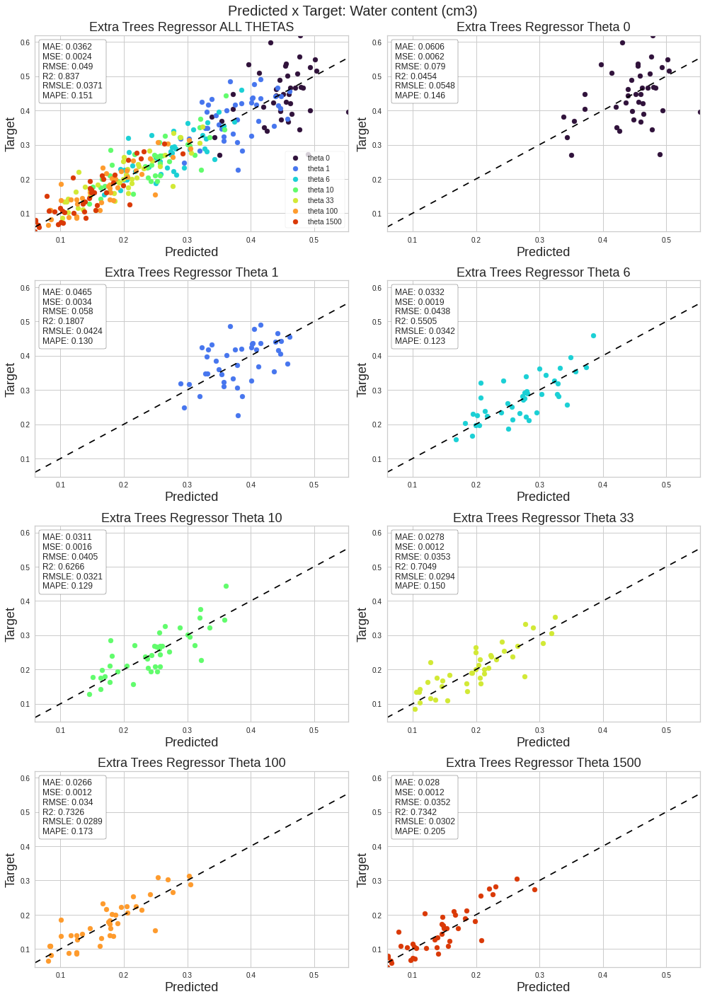

In [ ]:
all = plot_results_pyc('umidade', best[0], validation[c])

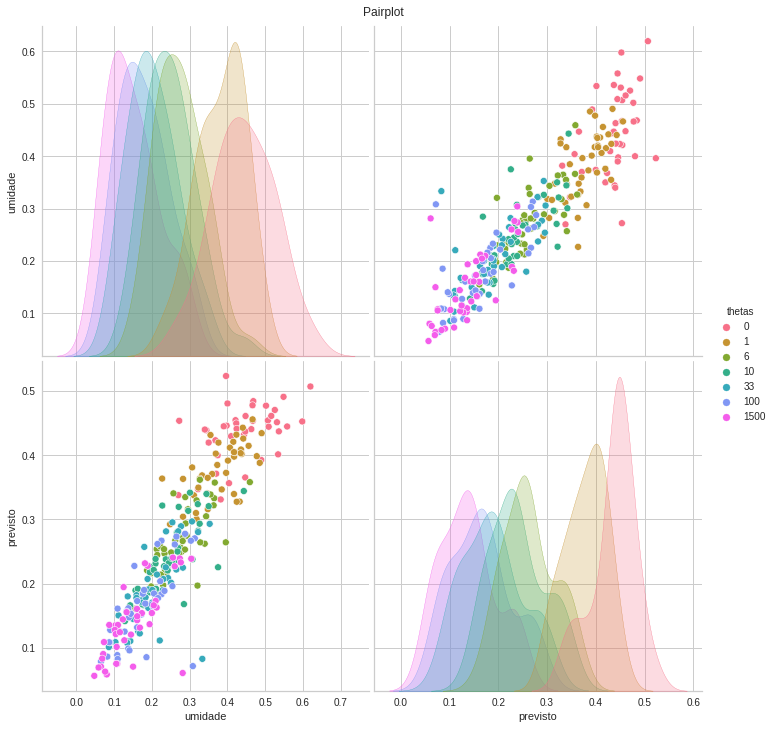

In [ ]:
sel = all[all.columns[-3:]]
sel['thetas'] = sel.thetas.apply(lambda x: str(x))
sel = sel.rename({'Label':'previsto'}, axis=1)
plot = sns.pairplot(sel, hue='thetas', height=5,);
plot.fig.suptitle("Pairplot", y=1.01);

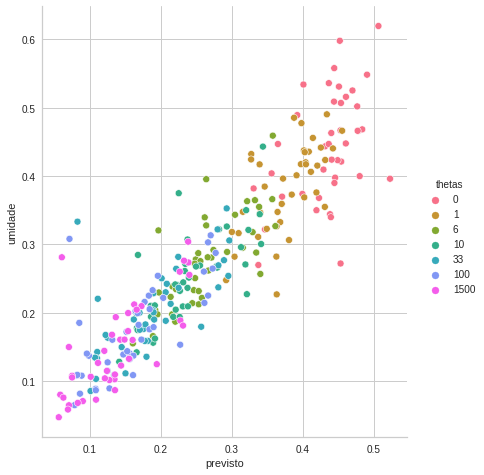

In [ ]:
plot = sns.relplot(data=sel, 
            x='previsto',
            y='umidade',
            hue='thetas');
plot.fig.set_size_inches(7, 7)

##Sumarização feature selection

In [ ]:
data.columns

Index(['argila', 'silte', 'areia', 'ds', 'ma', 'mi', 'c', 'elevation',
       'soilslope', 'aspect', 'curvature', 'plancurve', 'profilecurve',
       'thetas', 'umidade'],
      dtype='object')

In [ ]:
def prep_sel_data(*args):
  for df in args:
    df['classe'] = df.apply(lambda x: classe_textural(x.areia, x.argila, x.silte), 
                    axis=1)
    df['mt'] = df.ma + df.mi

In [ ]:
trn_sel, tst_sel = trn.copy(), tst.copy()
val_sel = validation.copy()

In [ ]:
prep_sel_data(trn_sel, tst_sel, val_sel)

In [ ]:
original_atributes = data.columns.to_list()
original_atributes

['argila',
 'silte',
 'areia',
 'ds',
 'ma',
 'mi',
 'c',
 'elevation',
 'soilslope',
 'aspect',
 'curvature',
 'plancurve',
 'profilecurve',
 'thetas',
 'umidade']

In [ ]:
sel_dic = {
    #Original
    'sel_0' : original_atributes,

    #Sem dados topograficos
    'sel_1' : ['argila', 'silte', 'areia', 'ds', 'ma', 'mi', 'c', 'thetas', 'umidade'],

    #Randon Search RNA
    'sel_2' : ['argila', 'ds', 'mi', 'c', 'curvature', 'plancurve', 'thetas', 'umidade'],
    
    #Genetico RNA
    'sel_3' : ['argila', 'silte', 'areia', 'mi', 'c', 'elevation', 'aspect',
            'plancurve', 'profilecurve', 'thetas', 'umidade'],
    
    #Genetico Catboost
    'sel_4' : ['argila', 'ds', 'ma', 'soilslope', 'profilecurve', 'thetas', 'umidade'], 
   
    #wraper 5 melhores modelos - n melhores feature
    'sel_5' : ['areia', 'silte', 'argila', 'c', 'ma', 'mi', 'ds', 'aspect', 
            'thetas', 'umidade'],

    #areia, argila, silte -> classe textural
    'sel_6' : ['classe'] + original_atributes[3:],
    
    #micro + macro = porosidade total 
    'sel_7' : ['argila',	'silte',	'areia', 'mt', 'ds', 'c',
            'elevation',	'soilslope',	'aspect',	'curvature',	
            'plancurve',	'profilecurve',	'thetas',	'umidade'],
    
    #argila, silte e areia
    'sel_8' : ['argila',	'silte',	'areia', 'thetas',	'umidade']
      
    }

In [ ]:
setup_kwargs = { 'data': None,
                  'test_data':None, 
                  'target': 'umidade',
                  'normalize': True, 
                  'session_id': 123, 
                  'silent': True, 
                  'numeric_features': ['thetas'],
                  'fold_strategy':fold_gen,
                  'use_gpu':True,
                  'verbose':False
                }

In [ ]:
def testing_selection_egineering(sel, trn, tst, val, **kwargs):
    kwargs['data'] = trn[sel_dic[sel]]
    kwargs['test_data'] = tst[sel_dic[sel]]
    
    exp_reg = setup(**kwargs)
    best_5 = compare_models(n_select=5, verbose=False)
    
    predict_model(best_5[0], data=val[sel_dic[sel]], verbose=False);
    best_df = pull()
   
    v = val[sel_dic[sel]] 
    predict_model(best_5[0], data=v.query('thetas == 0'), verbose=False);
    theta_0 = pull()['R2']
    
    best_df['0 R2'] = theta_0
    best_df.index = [sel]
    return best_df

In [ ]:
best_val = pd.DataFrame()
for sel in sel_dic.keys():
  best_df = testing_selection_egineering(sel, 
                                        trn_sel, 
                                        tst_sel, 
                                        val_sel, 
                                        **setup_kwargs)
  best_val = pd.concat([best_val, best_df])
  
best_val

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,0 R2
sel_0,Extra Trees Regressor,0.0351,0.0023,0.0477,0.8458,0.0358,0.1373,0.0543
sel_1,Extra Trees Regressor,0.0360,0.0023,0.0480,0.8433,0.0363,0.1425,0.1157
sel_2,Extra Trees Regressor,0.0353,0.0022,0.0474,0.8473,0.0357,0.1380,0.1240
sel_3,Extra Trees Regressor,0.0351,0.0022,0.0471,0.8494,0.0355,0.1370,0.1038
sel_4,Gradient Boosting Regressor,0.0396,0.0028,0.0529,0.8100,0.0399,0.1623,-0.0335
sel_5,CatBoost Regressor,0.0371,0.0025,0.0499,0.8311,0.0377,0.1529,0.0193
sel_6,CatBoost Regressor,0.0379,0.0025,0.0500,0.8304,0.0375,0.1516,-0.0457
sel_7,CatBoost Regressor,0.0415,0.0032,0.0563,0.7847,0.0427,0.1534,-0.0543
sel_8,Extra Trees Regressor,0.0492,0.0042,0.0649,0.7142,0.0502,0.1956,-0.0510


In [ ]:
best_val = pd.DataFrame()
for sel in sel_dic.keys():
  best_df = testing_selection_egineering(sel, 
                                        trn_sel, 
                                        tst_sel, 
                                        val_sel, 
                                        **setup_kwargs)
  best_val = pd.concat([best_val, best_df])
  
best_val

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,0 R2
sel_0,Extra Trees Regressor,0.0351,0.0023,0.0477,0.8458,0.0358,0.1373,0.0543
sel_1,Extra Trees Regressor,0.0360,0.0023,0.0480,0.8433,0.0363,0.1425,0.1157
sel_2,Extra Trees Regressor,0.0353,0.0022,0.0474,0.8473,0.0357,0.1380,0.1240
sel_3,Extra Trees Regressor,0.0351,0.0022,0.0471,0.8494,0.0355,0.1370,0.1038
sel_4,Gradient Boosting Regressor,0.0396,0.0028,0.0529,0.8100,0.0399,0.1623,-0.0335
sel_5,CatBoost Regressor,0.0371,0.0025,0.0499,0.8311,0.0377,0.1529,0.0193
sel_6,CatBoost Regressor,0.0379,0.0025,0.0500,0.8304,0.0375,0.1516,-0.0457
sel_7,CatBoost Regressor,0.0415,0.0032,0.0563,0.7847,0.0427,0.1534,-0.0543
sel_8,Extra Trees Regressor,0.0492,0.0042,0.0649,0.7142,0.0502,0.1956,-0.0510


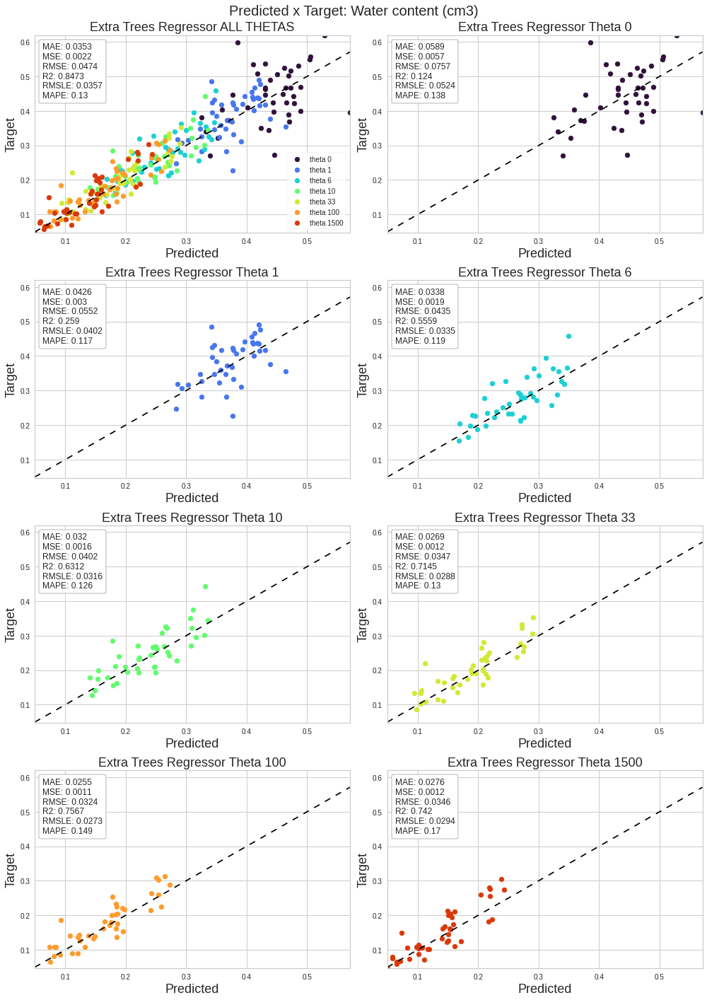

In [ ]:
all = test_model((trn_sel[sel_dic['sel_2']],
                  tst_sel[sel_dic['sel_2']], 
                  val_sel[sel_dic['sel_2']]), 
                  fold_gen)

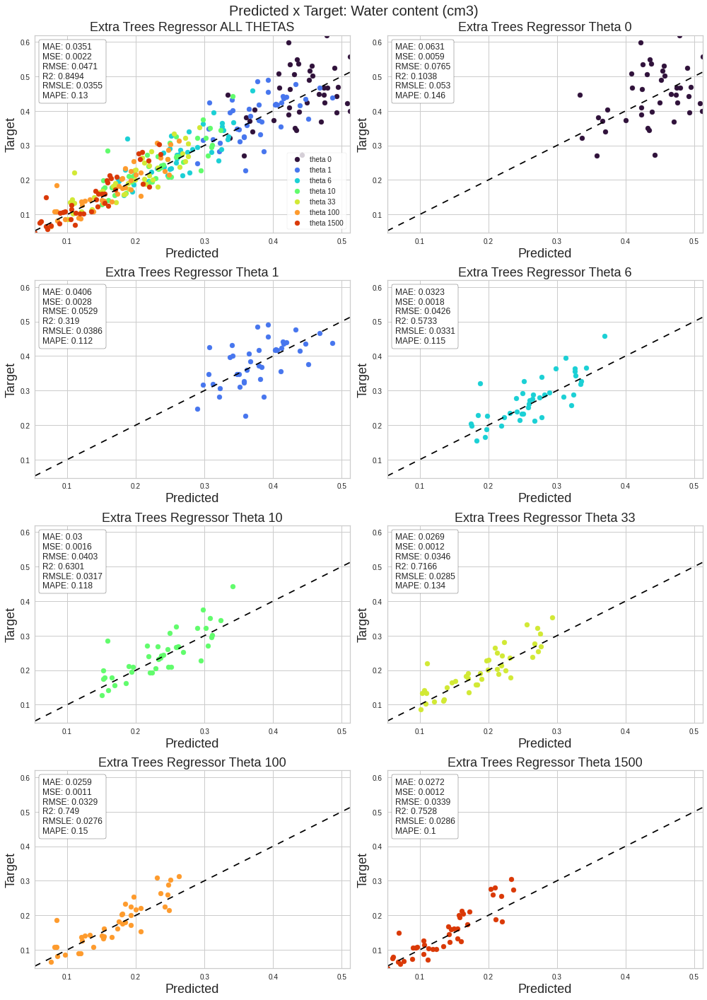

In [ ]:
all = test_model((trn_sel[sel_dic['sel_3']],
                  tst_sel[sel_dic['sel_3']], 
                  val_sel[sel_dic['sel_3']]), 
                  fold_gen)

In [ ]:
query = 'argila <= 30'

In [ ]:
best_val = pd.DataFrame()
for sel in sel_dic.keys():
  best_df = testing_selection_egineering(sel, 
                                        trn_sel.query(query), 
                                        tst_sel.query(query), 
                                        val_sel.query(query), 
                                        **setup_kwargs)
  best_val = pd.concat([best_val, best_df])
  
best_val

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,0 R2
sel_0,Random Forest Regressor,0.0416,0.0034,0.0582,0.7721,0.0455,0.1796,0.1748
sel_1,CatBoost Regressor,0.0393,0.0030,0.0544,0.8006,0.0416,0.1698,0.0171
sel_2,Random Forest Regressor,0.0420,0.0036,0.0599,0.7582,0.0469,0.1791,0.1568
sel_3,Random Forest Regressor,0.0431,0.0036,0.0600,0.7575,0.0468,0.1821,0.0670
sel_4,Extra Trees Regressor,0.0410,0.0029,0.0535,0.8071,0.0408,0.1827,0.0481
sel_5,Extra Trees Regressor,0.0376,0.0027,0.0523,0.8156,0.0397,0.1573,0.0002
sel_6,CatBoost Regressor,0.0354,0.0023,0.0477,0.8465,0.0363,0.1447,0.1490
sel_7,CatBoost Regressor,0.0373,0.0025,0.0500,0.8318,0.0378,0.1495,0.0472
sel_8,Gradient Boosting Regressor,0.0517,0.0052,0.0720,0.6507,0.0561,0.2285,-0.0053


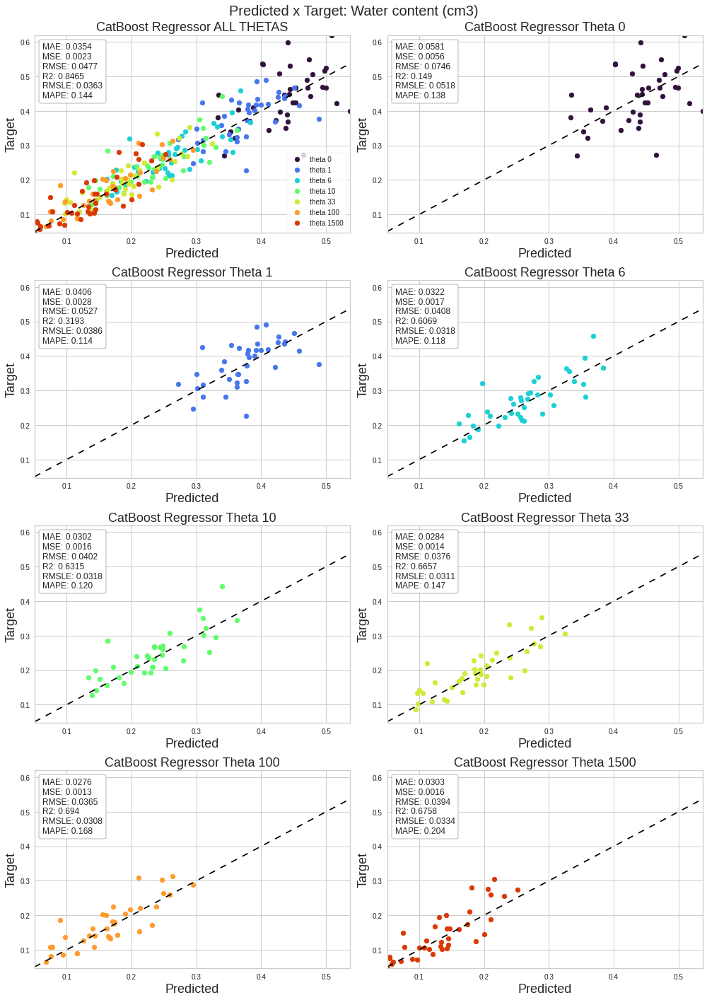

In [ ]:
all = test_model((trn_sel.query(query)[sel_dic['sel_6']],
                  tst_sel.query(query)[sel_dic['sel_6']], 
                  val_sel.query(query)[sel_dic['sel_6']]), 
                  fold_gen)

In [ ]:
data.sort_values('argila')[['argila', 'silte', 'areia', 'thetas', 'umidade']][:7]

,argila,silte,areia,thetas,umidade
154,4.72,44.92,50.36,0,0.5230
318,4.72,44.92,50.36,1,0.3977
974,4.72,44.92,50.36,100,0.1301
482,4.72,44.92,50.36,6,0.2376
646,4.72,44.92,50.36,10,0.2064
810,4.72,44.92,50.36,33,0.1566
1138,4.72,44.92,50.36,1500,0.1029


##<center><a href="#cell_indice">**&rarr; VOLTAR AO ÍNDICE**</a></center>